In [696]:
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt
import numpy as np
import glob
%matplotlib inline

In [697]:
#датафреймы с размеченными данными в среднем для песни

#df с динамическим измерением(за каждую секунду) arousal и valence
df_dynamic_arousal = pd.read_csv('audio_data/DEAM_Annotations/annotations/annotations averaged per song/dynamic (per second annotations)/arousal.csv', index_col='song_id')
df_dynamic_valence = pd.read_csv('audio_data/DEAM_Annotations/annotations/annotations averaged per song/dynamic (per second annotations)/valence.csv', index_col='song_id')

#df со статическими измерениями для всего фрагмента аудио
df_static_averaged_1_2000 = pd.read_csv('audio_data/DEAM_Annotations/annotations/annotations averaged per song/song_level/static_annotations_averaged_songs_1_2000.csv', index_col='song_id')
df_static_averaged_2000_2058 = pd.read_csv('audio_data/DEAM_Annotations/annotations/annotations averaged per song/song_level/static_annotations_averaged_songs_2000_2058.csv',index_col='song_id')

In [698]:
#датафреймы с размеченными данными для каждого оценщика для песни 2.mp3

#df с динамическим измерением(за каждую секунду) arousal и valence
df_dynamic_arousal_2 = pd.read_csv('audio_data/DEAM_Annotations/annotations/annotations per each rater/dynamic (per second annotations)/arousal/2.csv')
df_dynamic_valence_2 = pd.read_csv('audio_data/DEAM_Annotations/annotations/annotations per each rater/dynamic (per second annotations)/valence/2.csv')

#df со статическими измерениями для всего фрагмента аудио
df_static_annotations_songs_1_2000 = pd.read_csv('audio_data/DEAM_Annotations/annotations/annotations per each rater/song_level/static_annotations_songs_1_2000.csv')

In [699]:
#Посмотрим на данные для песни 2.mp3
df_dynamic_arousal_2

,sample_15000ms,sample_15500ms,sample_16000ms,sample_16500ms,sample_17000ms,sample_17500ms,sample_18000ms,sample_18500ms,sample_19000ms,sample_19500ms,...,sample_40000ms,sample_40500ms,sample_41000ms,sample_41500ms,sample_42000ms,sample_42500ms,sample_43000ms,sample_43500ms,sample_44000ms,sample_44500ms
0,0.069565,0.069565,0.069565,0.069565,0.069565,0.069565,0.069565,0.069565,0.069565,0.069565,...,0.013043,0.013043,0.013043,0.013043,0.013043,0.013043,0.013043,0.013043,0.013043,0.013043
1,-0.334780,-0.334780,-0.334780,-0.334780,-0.334780,-0.334780,-0.334780,-0.334780,-0.334780,-0.334780,...,-0.334780,-0.334780,-0.334780,-0.334780,-0.334780,-0.334780,-0.334780,-0.334780,-0.334780,-0.334780
2,-0.036811,-0.017793,-0.023913,-0.010870,-0.029466,-0.046365,-0.038966,-0.103960,-0.046054,-0.032225,...,0.090484,0.045753,0.028261,0.058696,0.033641,0.026854,0.034225,0.037743,0.038966,0.027969
3,0.418840,0.418840,0.418840,0.418840,0.418840,0.418840,0.418840,0.418840,0.418840,0.418840,...,-0.642570,-0.642570,-0.642570,-0.642570,-0.642570,-0.642570,-0.642570,-0.642570,-0.642570,-0.642570
4,-0.817390,-0.817390,-0.817390,-0.817390,-0.817390,-0.817390,-0.817390,-0.817390,-0.817390,-0.817390,...,-0.817390,-0.817390,-0.817390,-0.817390,-0.817390,-0.817390,-0.817390,-0.817390,-0.817390,-0.817390
5,-0.422210,-0.439600,-0.447440,-0.447440,-0.456130,-0.456130,-0.456130,-0.456130,-0.456130,-0.456130,...,-0.438750,-0.426940,-0.436320,-0.459200,-0.468490,-0.472800,-0.482190,-0.489450,-0.511110,-0.521290
6,-0.350000,-0.350000,-0.350000,-0.350000,-0.350000,-0.350000,-0.350000,-0.350000,-0.350000,-0.350000,...,-0.358700,-0.358700,-0.358700,-0.358700,-0.358700,-0.358700,-0.358700,-0.358700,-0.358700,-0.358700
7,0.508700,0.508700,0.508700,0.508700,0.508700,0.508700,0.508700,0.508700,0.508700,0.508700,...,0.508700,0.508700,0.508700,0.508700,0.508700,0.508700,0.508700,0.508700,0.508700,0.508700
8,0.047826,0.056522,0.056522,0.056522,0.056522,0.006003,-0.037964,-0.051545,-0.052174,-0.052174,...,-0.258610,-0.252170,-0.252170,-0.252170,-0.252170,-0.245880,-0.241520,-0.230860,-0.224140,-0.215460
9,-0.177600,-0.243480,-0.244230,-0.279280,-0.330430,-0.330430,-0.330430,-0.330430,-0.330430,-0.330430,...,-0.330430,-0.330430,-0.330430,-0.330430,-0.330430,-0.330430,-0.330430,-0.330430,-0.330430,-0.330430


In [700]:
df_dynamic_valence_2

,sample_15000ms,sample_15500ms,sample_16000ms,sample_16500ms,sample_17000ms,sample_17500ms,sample_18000ms,sample_18500ms,sample_19000ms,sample_19500ms,...,sample_40000ms,sample_40500ms,sample_41000ms,sample_41500ms,sample_42000ms,sample_42500ms,sample_43000ms,sample_43500ms,sample_44000ms,sample_44500ms
0,-0.039130,-0.039130,-0.039130,-0.039130,-0.039130,-0.039130,-0.039130,-0.039130,-0.039130,-0.039130,...,-0.082609,-0.082609,-0.082609,-0.091304,-0.091304,-0.091304,-0.091304,-0.091304,-0.091304,-0.091304
1,-0.521740,-0.521740,-0.521740,-0.521740,-0.521740,-0.521740,-0.521740,-0.521740,-0.521740,-0.521740,...,-0.521740,-0.521740,-0.521740,-0.521740,-0.521740,-0.521740,-0.521740,-0.521740,-0.521740,-0.521740
2,-0.384860,-0.399610,-0.402170,-0.402170,-0.402170,-0.389840,-0.405020,-0.390790,-0.375680,-0.390280,...,-0.493480,-0.489130,-0.469510,-0.478000,-0.484780,-0.476090,-0.467590,-0.471740,-0.485570,-0.489130
3,0.088233,0.088233,0.088233,0.088233,0.088233,0.088233,0.088233,0.088233,0.088233,0.088233,...,-0.372870,-0.372870,-0.372870,-0.372870,-0.372870,-0.372870,-0.372870,-0.372870,-0.372870,-0.372870
4,0.834780,0.834780,0.834780,0.834780,0.834780,0.834780,0.834780,0.834780,0.834780,0.834780,...,-0.639130,-0.639130,-0.639130,-0.639130,-0.639130,-0.639130,-0.639130,-0.639130,-0.639130,-0.639130
5,-0.191140,-0.189590,-0.181190,-0.221960,-0.256300,-0.261480,-0.273680,-0.273250,-0.283230,-0.291050,...,-0.386620,-0.390960,-0.390960,-0.395310,-0.395310,-0.395380,-0.404000,-0.404000,-0.404000,-0.391030
6,-0.319560,-0.319560,-0.319560,-0.319560,-0.319560,-0.319560,-0.319560,-0.319560,-0.319560,-0.319560,...,-0.319560,-0.319560,-0.319560,-0.319560,-0.319560,-0.319560,-0.319560,-0.321260,-0.328260,-0.328260
7,0.143480,0.143480,0.143480,0.143480,0.143480,0.143480,0.143480,0.143480,0.143480,0.143480,...,0.143480,0.143480,0.143480,0.143480,0.143480,0.143480,0.143480,0.143480,0.143480,0.143480
8,-0.173910,-0.173910,-0.173910,-0.173910,-0.173910,-0.173910,-0.173910,-0.173910,-0.173910,-0.173910,...,-0.327520,-0.333280,-0.337580,-0.341900,-0.350560,-0.354840,-0.356520,-0.356520,-0.360870,-0.365870
9,-0.169560,-0.169560,-0.169560,-0.169560,-0.169560,-0.169560,-0.169560,-0.169560,-0.169560,-0.169560,...,-0.173710,-0.242660,-0.256320,-0.264790,-0.269570,-0.273910,-0.282410,-0.282610,-0.282610,-0.282610


In [701]:
df_static_annotations_songs_1_2000

,workerID,SongId,Valence,Arousal
0,6010bbc8e7ef4b21fa38f9c3a9754ef3,2,5,2
1,3c888e77b992ae3cd2adfe16774e23b9,2,2,3
2,2afd218c3aecb6828d2be327f8b9c46f,2,3,3
3,fd5b08ce362d855ca9152a894348130c,2,4,4
4,9c8073214a052e414811b76012df8847,2,2,2
...,...,...,...,...
17459,607f6e34a0b5923333f6b16d3a59cc98,2000,6,5
17460,78b5e9744073532cc376976b5fc6b2fc,2000,7,7
17461,7cecbffe1da5ae974952db6c13695afe,2000,4,5
17462,ed7ed76453bd846859f5e6b9149df276,2000,6,7


In [702]:
df_static_2 = df_static_annotations_songs_1_2000[df_static_annotations_songs_1_2000[' SongId']==2]
df_static_2

,workerID,SongId,Valence,Arousal
0,6010bbc8e7ef4b21fa38f9c3a9754ef3,2,5,2
1,3c888e77b992ae3cd2adfe16774e23b9,2,2,3
2,2afd218c3aecb6828d2be327f8b9c46f,2,3,3
3,fd5b08ce362d855ca9152a894348130c,2,4,4
4,9c8073214a052e414811b76012df8847,2,2,2
5,6b492acb1838463dc7c07a76b26313c4,2,3,4
6,8dcd4de7be6479561269b90c1dc8a3b4,2,3,3
7,cbc86e332e889251fe0fa71df472f202,2,4,3
8,259443e9cad56b4f68b664daa20cb323,2,2,3
9,5bf3c29fd496e2cafa9c531c7e9c6d61,2,3,3


<AxesSubplot:ylabel=' Valence'>

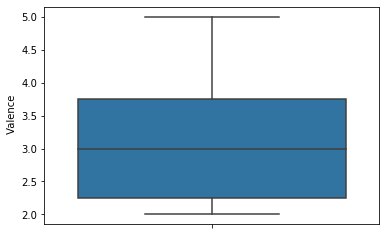

In [703]:
#Посмотрим на распределение оценки valence для всех оценщиков
sns.boxplot(y=df_static_2[' Valence'])

<AxesSubplot:ylabel=' Arousal'>

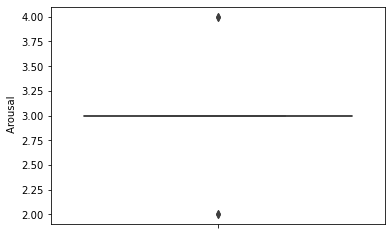

In [704]:
#Посмотрим на распределение оценки arousal для всех оценщиков
sns.boxplot(y=df_static_2[' Arousal'])

<AxesSubplot:ylabel='mean'>

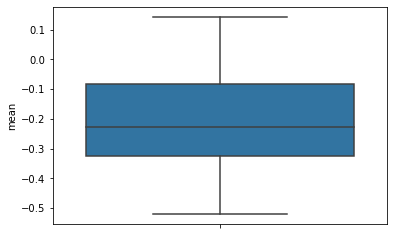

In [705]:
sns.boxplot(y=df_dynamic_valence_2.T.describe().T['mean'])

<AxesSubplot:ylabel='mean'>

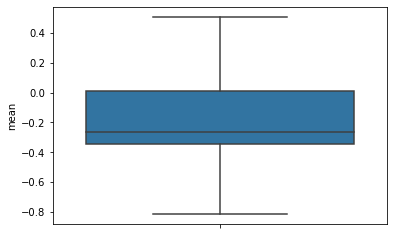

In [706]:
sns.boxplot(y=df_dynamic_arousal_2.T.describe().T['mean'])

<AxesSubplot:title={'center':'boxplot'}>

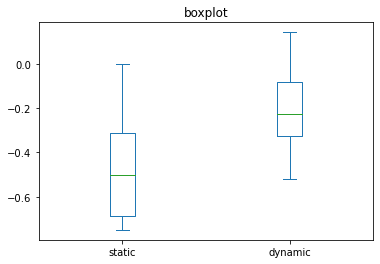

In [707]:
#Сравним средние оценки динамические со статическими
#Нормализатор из 9-бальной шкалы в [-1,1]
def normilize(x):
    return ((x-5)/4)

valence_2 = pd.DataFrame({"static": normilize(df_static_2[' Valence']), "dynamic": df_dynamic_valence_2.T.describe().T['mean']})
valence_2.plot(kind='box', title='boxplot')

<AxesSubplot:title={'center':'boxplot'}>

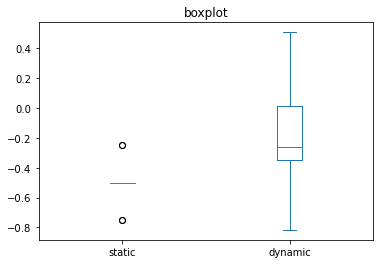

In [708]:
arousal_2 = pd.DataFrame({"static": normilize(df_static_2[' Arousal']), "dynamic": df_dynamic_arousal_2.T.describe().T['mean']})
arousal_2.plot(kind='box', title='boxplot')

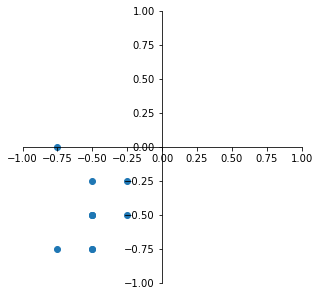

In [709]:
fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(1, 1, 1)

ax.spines['left'].set_position('center')
ax.spines['bottom'].set_position('center')
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')
plt.scatter(x=normilize(df_static_2[' Arousal']), y=normilize(df_static_2[' Valence']))
plt.xlim(-1, 1)
plt.ylim(-1, 1)
plt.show()

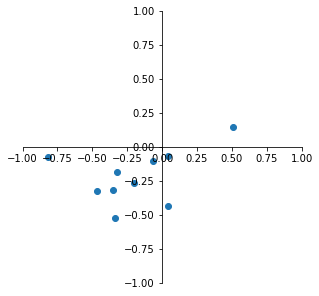

In [710]:
fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(1, 1, 1)

ax.spines['left'].set_position('center')
ax.spines['bottom'].set_position('center')
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')
plt.scatter(x=df_dynamic_arousal_2.T.describe().T['mean'], y=df_dynamic_valence_2.T.describe().T['mean'])
plt.xlim(-1, 1)
plt.ylim(-1, 1)
plt.show()

In [711]:
#Посмотрим на данные для песни 1000.mp3
#датафреймы с размеченными данными для каждого оценщика для песни 1010.mp3

#df с динамическим измерением(за каждую секунду) arousal и valence
df_dynamic_arousal_1010 = pd.read_csv('audio_data/DEAM_Annotations/annotations/annotations per each rater/dynamic (per second annotations)/arousal/1010.csv')
df_dynamic_valence_1010 = pd.read_csv('audio_data/DEAM_Annotations/annotations/annotations per each rater/dynamic (per second annotations)/valence/1010.csv')

In [712]:
df_dynamic_arousal_1010

,WorkerId,sample_15000ms,sample_15500ms,sample_16000ms,sample_16500ms,sample_17000ms,sample_17500ms,sample_18000ms,sample_18500ms,sample_19000ms,...,sample_40000ms,sample_40500ms,sample_41000ms,sample_41500ms,sample_42000ms,sample_42500ms,sample_43000ms,sample_43500ms,sample_44000ms,sample_44500ms
0,46a2289decf79f747406fa91cd92fc27,0.22,0.10,-0.07,-0.07,-0.07,-0.07,-0.07,-0.07,-0.07,...,-0.08,-0.08,-0.08,-0.08,-0.08,-0.08,-0.08,-0.08,-0.08,-0.08
1,78b5e9744073532cc376976b5fc6b2fc,-0.10,-0.06,-0.02,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,...,0.47,0.47,0.47,0.47,0.47,0.47,0.47,0.47,0.47,0.47
2,b09a5957e5d5e47e556d203529a0ae6d,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.08,...,0.36,0.37,0.38,0.38,0.38,0.38,0.39,0.39,0.39,0.39
3,00de940f0b5cfc82cca4791199e3bfb3,0.32,0.32,0.32,0.32,0.32,0.32,0.32,0.32,0.32,...,0.87,0.89,0.89,0.91,0.92,0.93,0.96,1.00,1.00,1.00
4,accbf566ae920d6260d28454e1ee0d6a,-0.55,-0.55,-0.55,-0.55,-0.55,-0.55,-0.55,-0.55,-0.55,...,0.24,0.24,0.24,0.24,0.24,0.24,0.24,0.31,0.52,0.59
5,de2b2c35312ac2f0a8510743742c0219,0.04,0.03,0.03,0.00,0.01,0.01,0.03,0.02,-0.00,...,0.90,0.90,0.92,0.95,0.96,0.92,0.95,0.91,0.88,0.94
6,607f6e34a0b5923333f6b16d3a59cc98,0.34,0.36,0.35,0.34,0.32,0.28,0.28,0.30,0.30,...,0.45,0.47,0.44,0.45,0.46,0.41,0.50,0.49,0.50,0.48
7,ff9c1993d2a21f2117c30d8e295dd4ac,-0.50,-0.50,-0.50,-0.50,-0.50,-0.50,-0.50,-0.50,-0.50,...,0.43,0.43,0.43,0.43,0.43,0.43,0.43,0.43,0.43,0.43
8,ed7ed76453bd846859f5e6b9149df276,0.20,0.20,0.20,0.21,0.21,0.25,0.29,0.30,0.30,...,0.49,0.49,0.49,0.49,0.49,0.49,0.49,0.49,0.49,0.49
9,a30d244141cb2f51e0803e79bc4bd147,0.67,0.67,0.67,0.67,0.67,0.67,0.67,0.67,0.67,...,0.67,0.67,0.67,0.67,0.67,0.67,0.67,0.67,0.67,0.67


In [713]:
df_dynamic_valence_1010

,WorkerId,sample_15000ms,sample_15500ms,sample_16000ms,sample_16500ms,sample_17000ms,sample_17500ms,sample_18000ms,sample_18500ms,sample_19000ms,...,sample_40000ms,sample_40500ms,sample_41000ms,sample_41500ms,sample_42000ms,sample_42500ms,sample_43000ms,sample_43500ms,sample_44000ms,sample_44500ms
0,46a2289decf79f747406fa91cd92fc27,0.11,0.11,0.12,0.14,0.15,0.15,0.15,0.15,0.15,...,0.24,0.24,0.24,0.24,0.24,0.24,0.24,0.24,0.24,0.24
1,78b5e9744073532cc376976b5fc6b2fc,0.57,0.57,0.57,0.57,0.57,0.57,0.57,0.57,0.57,...,0.57,0.55,0.46,0.46,0.46,0.46,0.46,0.46,0.47,0.56
2,b09a5957e5d5e47e556d203529a0ae6d,0.11,0.11,0.11,0.11,0.13,0.15,0.17,0.18,0.18,...,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.27,0.31
3,00de940f0b5cfc82cca4791199e3bfb3,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00
4,accbf566ae920d6260d28454e1ee0d6a,0.43,0.43,0.43,0.43,0.43,0.43,0.43,0.43,0.43,...,0.66,0.66,0.66,0.55,0.55,0.55,0.59,0.63,0.63,0.75
5,de2b2c35312ac2f0a8510743742c0219,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.01,0.03,...,0.92,0.94,0.94,0.92,0.93,0.92,0.91,0.95,0.93,0.92
6,607f6e34a0b5923333f6b16d3a59cc98,0.26,0.26,0.27,0.28,0.28,0.28,0.28,0.29,0.28,...,0.41,0.41,0.41,0.38,0.43,0.39,0.49,0.46,0.47,0.44
7,ff9c1993d2a21f2117c30d8e295dd4ac,-0.02,-0.02,-0.02,-0.02,-0.02,-0.02,-0.02,-0.02,-0.02,...,-0.33,-0.33,-0.33,-0.33,-0.33,-0.33,-0.33,-0.33,-0.33,-0.33
8,ed7ed76453bd846859f5e6b9149df276,0.48,0.48,0.48,0.48,0.48,0.48,0.48,0.48,0.48,...,0.53,0.53,0.53,0.53,0.53,0.53,0.53,0.53,0.53,0.53
9,a30d244141cb2f51e0803e79bc4bd147,0.69,0.69,0.69,0.69,0.69,0.69,0.69,0.69,0.69,...,0.69,0.69,0.69,0.69,0.69,0.69,0.69,0.69,0.69,0.69


In [714]:
df_static_1010 = df_static_annotations_songs_1_2000[df_static_annotations_songs_1_2000[' SongId']==1010]
df_static_1010

,workerID,SongId,Valence,Arousal
7554,46a2289decf79f747406fa91cd92fc27,1010,5,5
7555,78b5e9744073532cc376976b5fc6b2fc,1010,7,7
7556,b09a5957e5d5e47e556d203529a0ae6d,1010,6,6
7557,00de940f0b5cfc82cca4791199e3bfb3,1010,9,9
7558,accbf566ae920d6260d28454e1ee0d6a,1010,8,7
7559,de2b2c35312ac2f0a8510743742c0219,1010,9,9
7560,607f6e34a0b5923333f6b16d3a59cc98,1010,6,5
7561,ff9c1993d2a21f2117c30d8e295dd4ac,1010,4,5
7562,ed7ed76453bd846859f5e6b9149df276,1010,5,5
7563,a30d244141cb2f51e0803e79bc4bd147,1010,6,7


<AxesSubplot:ylabel=' Valence'>

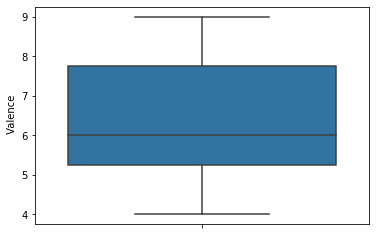

In [715]:
#Посмотрим на распределение оценки valence для всех оценщиков
sns.boxplot(y=df_static_1010[' Valence'])

<AxesSubplot:ylabel=' Arousal'>

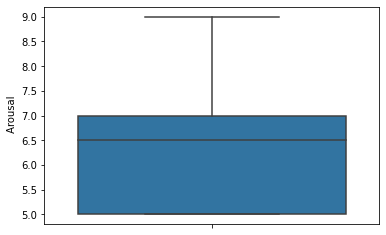

In [716]:
#Посмотрим на распределение оценки arousal для всех оценщиков
sns.boxplot(y=df_static_1010[' Arousal'])

<AxesSubplot:ylabel='mean'>

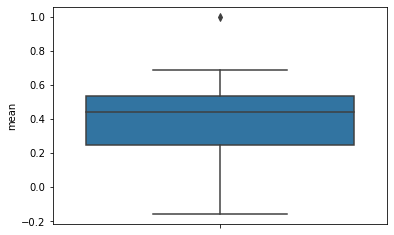

In [717]:
sns.boxplot(y=df_dynamic_valence_1010.drop(['WorkerId'],axis=1).T.describe().T['mean'])

<AxesSubplot:ylabel='mean'>

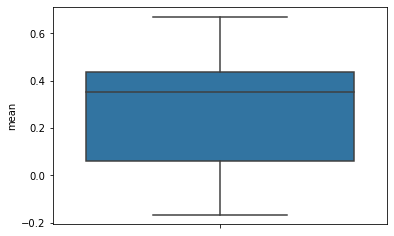

In [718]:
sns.boxplot(y=df_dynamic_arousal_1010.drop(['WorkerId'],axis=1).T.describe().T['mean'])

<AxesSubplot:title={'center':'boxplot'}>

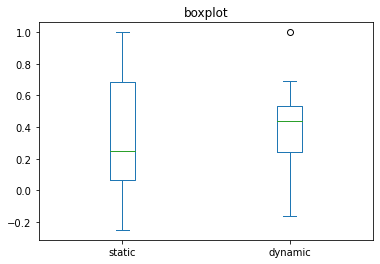

In [719]:
valence_1010 = pd.DataFrame({"static": normilize(df_static_1010[' Valence']), "dynamic": df_dynamic_valence_1010.drop(['WorkerId'],axis=1).T.describe().T['mean']})
valence_1010.plot(kind='box', title='boxplot')

<AxesSubplot:title={'center':'boxplot'}>

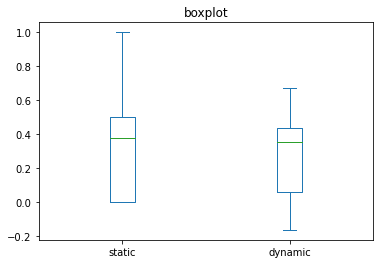

In [720]:
arousal_1010 = pd.DataFrame({"static": normilize(df_static_1010[' Arousal']), "dynamic": df_dynamic_arousal_1010.drop(['WorkerId'],axis=1).T.describe().T['mean']})
arousal_1010.plot(kind='box', title='boxplot')

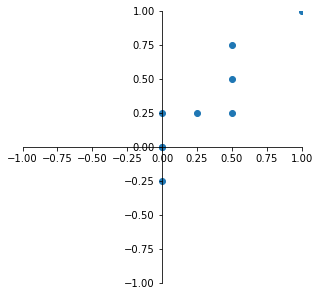

In [721]:
fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(1, 1, 1)

ax.spines['left'].set_position('center')
ax.spines['bottom'].set_position('center')
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')
plt.scatter(x=normilize(df_static_1010[' Arousal']), y=normilize(df_static_1010[' Valence']))
plt.xlim(-1, 1)
plt.ylim(-1, 1)
plt.show()

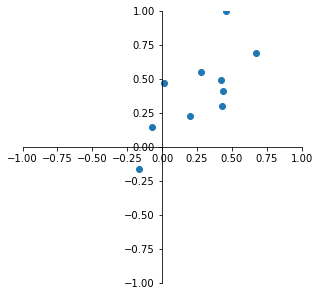

In [722]:
fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(1, 1, 1)

ax.spines['left'].set_position('center')
ax.spines['bottom'].set_position('center')
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')
plt.scatter(x=df_dynamic_arousal_1010.drop(['WorkerId'],axis=1).T.describe().T['mean'], y=df_dynamic_valence_1010.drop(['WorkerId'],axis=1).T.describe().T['mean'])
plt.xlim(-1, 1)
plt.ylim(-1, 1)
plt.show()

In [723]:
def find_outliers(df):
    q1=df.quantile(0.25)
    q3=df.quantile(0.75)
    IQR=q3-q1
    outliers = df[((df<(q1-1.5*IQR)) | (df>(q3+1.5*IQR)))]
    return outliers

In [724]:
#количество оценщиков для 2013-2014 статических измерений
len(df_static_annotations_songs_1_2000['workerID'].unique())

187

In [725]:
#подсчёт количества выбросов для каждого работника и для каждого статического измерения

#словарь, содержащий количество выбросов в arousal для определенного работника
dict_arousal_outliers_s = {}
#словарь, содержащий количество выбросов в valence для определенного работника
dict_valence_outliers_s = {}
dict_arousal_outliers_s = dict_arousal_outliers_s.fromkeys(df_static_annotations_songs_1_2000['workerID'].unique(), 0)
dict_valence_outliers_s = dict_valence_outliers_s.fromkeys(df_static_annotations_songs_1_2000['workerID'].unique(), 0)

df_metadata_2013 = pd.read_csv('audio_data/metadata/metadata_2013.csv')
df_metadata_2014 = pd.read_csv('audio_data/metadata/metadata_2014.csv', usecols=['Id','Artist','Album','Track','Genre','segment start','segment end','last.fm labels'])

for i in df_metadata_2014['Id']:
    outliers_arousal_s = find_outliers(df_static_annotations_songs_1_2000[df_static_annotations_songs_1_2000[' SongId'] == i][' Arousal'])
    for j in outliers_arousal_s.index:
        dict_arousal_outliers_s[df_static_annotations_songs_1_2000[df_static_annotations_songs_1_2000[' SongId'] == i].loc[j]['workerID']]+=1
    outliers_valence_s = find_outliers(df_static_annotations_songs_1_2000[df_static_annotations_songs_1_2000[' SongId'] == i][' Valence'])
    for j in outliers_valence_s.index:
        dict_valence_outliers_s[df_static_annotations_songs_1_2000[df_static_annotations_songs_1_2000[' SongId'] == i].loc[j]['workerID']]+=1        

print(dict_arousal_outliers_s,'\n')
print(dict_valence_outliers_s,'\n')

dict_arousal_outliers_s_2014 = dict_arousal_outliers_s.copy()
dict_valence_outliers_s_2014 = dict_valence_outliers_s.copy()
        
for i in df_metadata_2013['song_id']:
    outliers_arousal_s = find_outliers(df_static_annotations_songs_1_2000[df_static_annotations_songs_1_2000[' SongId'] == i][' Arousal'])
    for j in outliers_arousal_s.index:
        dict_arousal_outliers_s[df_static_annotations_songs_1_2000[df_static_annotations_songs_1_2000[' SongId'] == i].loc[j]['workerID']]+=1
    outliers_valence_s = find_outliers(df_static_annotations_songs_1_2000[df_static_annotations_songs_1_2000[' SongId'] == i][' Valence'])
    for j in outliers_valence_s.index:
        dict_valence_outliers_s[df_static_annotations_songs_1_2000[df_static_annotations_songs_1_2000[' SongId'] == i].loc[j]['workerID']]+=1

print(dict_arousal_outliers_s,'\n')
print(dict_valence_outliers_s)

{'6010bbc8e7ef4b21fa38f9c3a9754ef3': 0, '3c888e77b992ae3cd2adfe16774e23b9': 0, '2afd218c3aecb6828d2be327f8b9c46f': 0, 'fd5b08ce362d855ca9152a894348130c': 0, '9c8073214a052e414811b76012df8847': 0, '6b492acb1838463dc7c07a76b26313c4': 0, '8dcd4de7be6479561269b90c1dc8a3b4': 0, 'cbc86e332e889251fe0fa71df472f202': 0, '259443e9cad56b4f68b664daa20cb323': 0, '5bf3c29fd496e2cafa9c531c7e9c6d61': 0, 'bf34e3c5724ce07d29ef12db5f767258': 0, '514278711fcdb6dfb235c03a3aa38ee3': 0, '4eb43aa7f89260bb40b3970a45a82678': 0, 'ed7ed76453bd846859f5e6b9149df276': 18, '571d66ea4abfb694d9bb1281d7701710': 0, 'd84d58533b58797bccca5811b4135c95': 0, '490951556961e4b88fe1a3ac53b3b186': 0, '2c5952c4f931410e9010eb87c276020d': 0, '0c37993dcf5f99f7b00d02495ed01bc3': 0, '64cae7b86c7dcb1b40d17e43c0c2109e': 0, '24ebcf86498b0f2793b55c5b9a7756b5': 0, '94d7a0f7c8f2e1c714b0649f835c538c': 0, 'a00de41fdf121f6dfe5db851a575d2d1': 0, '7cecbffe1da5ae974952db6c13695afe': 19, 'eca1130f44cd2e17645e40a0fa2ef59b': 12, 'd8e56509dc582df25573

{'6010bbc8e7ef4b21fa38f9c3a9754ef3': 11, '3c888e77b992ae3cd2adfe16774e23b9': 0, '2afd218c3aecb6828d2be327f8b9c46f': 22, 'fd5b08ce362d855ca9152a894348130c': 15, '9c8073214a052e414811b76012df8847': 12, '6b492acb1838463dc7c07a76b26313c4': 17, '8dcd4de7be6479561269b90c1dc8a3b4': 27, 'cbc86e332e889251fe0fa71df472f202': 6, '259443e9cad56b4f68b664daa20cb323': 24, '5bf3c29fd496e2cafa9c531c7e9c6d61': 1, 'bf34e3c5724ce07d29ef12db5f767258': 4, '514278711fcdb6dfb235c03a3aa38ee3': 7, '4eb43aa7f89260bb40b3970a45a82678': 136, 'ed7ed76453bd846859f5e6b9149df276': 30, '571d66ea4abfb694d9bb1281d7701710': 1, 'd84d58533b58797bccca5811b4135c95': 1, '490951556961e4b88fe1a3ac53b3b186': 11, '2c5952c4f931410e9010eb87c276020d': 2, '0c37993dcf5f99f7b00d02495ed01bc3': 5, '64cae7b86c7dcb1b40d17e43c0c2109e': 33, '24ebcf86498b0f2793b55c5b9a7756b5': 4, '94d7a0f7c8f2e1c714b0649f835c538c': 1, 'a00de41fdf121f6dfe5db851a575d2d1': 11, '7cecbffe1da5ae974952db6c13695afe': 33, 'eca1130f44cd2e17645e40a0fa2ef59b': 16, 'd8e56509

In [726]:
#песня, которую оценил 1 работник 2 раза
df_static_annotations_songs_1_2000[df_static_annotations_songs_1_2000[' SongId'] == 323]

,workerID,SongId,Valence,Arousal
2730,6010bbc8e7ef4b21fa38f9c3a9754ef3,323,7,6
2731,bf34e3c5724ce07d29ef12db5f767258,323,4,6
2732,24ebcf86498b0f2793b55c5b9a7756b5,323,5,4
2733,38531641e6c0628757776b0088bcc854,323,6,6
2734,2afd218c3aecb6828d2be327f8b9c46f,323,3,5
2735,fd5b08ce362d855ca9152a894348130c,323,6,4
2736,9c8073214a052e414811b76012df8847,323,6,7
2737,64cae7b86c7dcb1b40d17e43c0c2109e,323,3,3
2738,64cae7b86c7dcb1b40d17e43c0c2109e,323,4,8
2739,259443e9cad56b4f68b664daa20cb323,323,3,7


In [727]:
#подсчёт количества выбросов для каждого работника и для каждого среднего динамического измерения

#словарь, содержащий количество выбросов в arousal для определенного работника
dict_arousal_outliers_d = {}
dict_arousal_outliers_d = dict_arousal_outliers_d.fromkeys(df_static_annotations_songs_1_2000['workerID'].unique(), 0)
#словарь, содержащий количество выбросов в valence для определенного работника
dict_valence_outliers_d = {}
dict_valence_outliers_d = dict_valence_outliers_d.fromkeys(df_static_annotations_songs_1_2000['workerID'].unique(), 0)

directory = 'audio_data/DEAM_Annotations/annotations/annotations per each rater/dynamic (per second annotations)'

#в 2013 не собиралась информация по id работникам для динамических измерений
for i in df_metadata_2014['Id']:
    df_arousal_d = pd.read_csv(glob.glob(directory + '/arousal/' + str(i) + '.csv')[0])
    if ('WorkerId' in df_arousal_d.columns):
        #print(i)
        #print(df_arousal_d)
        index_series = df_arousal_d['WorkerId']
        df_arousal_d_mean = df_arousal_d.drop('WorkerId', axis=1).T.describe().T['mean']
        #print(df_arousal_d_mean)
        #print(index_series)
        df_arousal_d_mean = df_arousal_d_mean.set_axis(index_series)
        #print(df_arousal_d_mean)
        ######
        outliers_arousal_d = find_outliers(df_arousal_d_mean)
        #print(outliers_arousal_d)
        for j in outliers_arousal_d.index:
            dict_arousal_outliers_d[j]+=1
    df_valence_d = pd.read_csv(glob.glob(directory + '/valence/' + str(i) + '.csv')[0])
    if ('WorkerId' in df_valence_d.columns):
        #print(i)
        #print(df_valence_d)
        df_valence_d_mean = df_valence_d.drop('WorkerId', axis=1).T.describe().T['mean']
        index_series = df_valence_d['WorkerId']
        #print(df_valence_d_mean)
        #print(index_series)
        df_valence_d_mean = df_valence_d_mean.set_axis(index_series)
        #print(df_valence_d_mean)
        #####
        outliers_valence_d = find_outliers(df_valence_d_mean)
        #print(outliers_valence_d)
        for j in outliers_valence_d.index:
            dict_valence_outliers_d[j]+=1
            
print(dict_arousal_outliers_d,'\n')
print(dict_valence_outliers_d)

{'6010bbc8e7ef4b21fa38f9c3a9754ef3': 0, '3c888e77b992ae3cd2adfe16774e23b9': 0, '2afd218c3aecb6828d2be327f8b9c46f': 0, 'fd5b08ce362d855ca9152a894348130c': 0, '9c8073214a052e414811b76012df8847': 0, '6b492acb1838463dc7c07a76b26313c4': 0, '8dcd4de7be6479561269b90c1dc8a3b4': 0, 'cbc86e332e889251fe0fa71df472f202': 0, '259443e9cad56b4f68b664daa20cb323': 0, '5bf3c29fd496e2cafa9c531c7e9c6d61': 0, 'bf34e3c5724ce07d29ef12db5f767258': 0, '514278711fcdb6dfb235c03a3aa38ee3': 0, '4eb43aa7f89260bb40b3970a45a82678': 0, 'ed7ed76453bd846859f5e6b9149df276': 7, '571d66ea4abfb694d9bb1281d7701710': 0, 'd84d58533b58797bccca5811b4135c95': 0, '490951556961e4b88fe1a3ac53b3b186': 0, '2c5952c4f931410e9010eb87c276020d': 0, '0c37993dcf5f99f7b00d02495ed01bc3': 0, '64cae7b86c7dcb1b40d17e43c0c2109e': 0, '24ebcf86498b0f2793b55c5b9a7756b5': 0, '94d7a0f7c8f2e1c714b0649f835c538c': 0, 'a00de41fdf121f6dfe5db851a575d2d1': 0, '7cecbffe1da5ae974952db6c13695afe': 24, 'eca1130f44cd2e17645e40a0fa2ef59b': 32, 'd8e56509dc582df255732

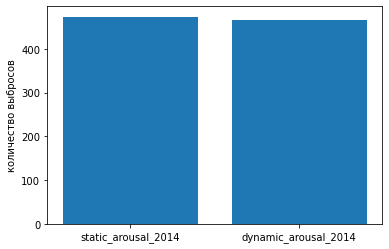

In [728]:
#сравнение количества выбросов в arousal в статике и динамике в 2014 году
plt.bar(['static_arousal_2014','dynamic_arousal_2014'], [sum(dict_arousal_outliers_s_2014.values()),sum(dict_arousal_outliers_d.values())])
plt.ylabel('количество выбросов')
plt.show()

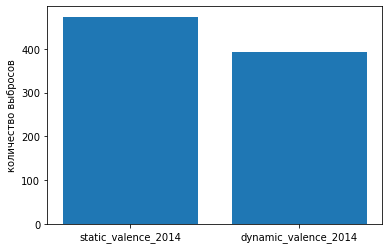

In [729]:
#сравнение количества выбросов в valence в статике и динамике в 2014 году
plt.bar(['static_valence_2014','dynamic_valence_2014'], [sum(dict_valence_outliers_s_2014.values()),sum(dict_valence_outliers_d.values())])
plt.ylabel('количество выбросов')
plt.show()

Количество работников всего = 187
Количество работников с 0 outlier = 91
[182, 108, 35, 34, 31, 28, 26, 24, 24, 20]


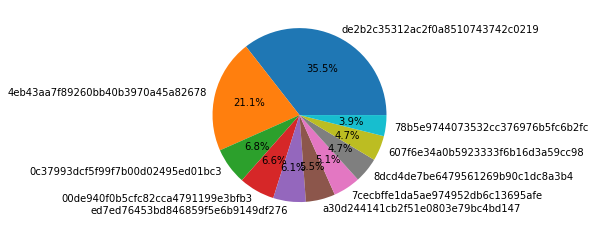

In [730]:
#топ-10 работников по количеству выбросов в static_valence
print('Количество работников всего =', len(dict_valence_outliers_s))
print('Количество работников с 0 outlier =', len([k for k, v in dict_valence_outliers_s.items() if v==0]))
print([i[1] for i in sorted(dict_valence_outliers_s.items(), key=lambda item: item[1], reverse=True)[:10]])
plt.pie([i[1] for i in sorted(dict_valence_outliers_s.items(), key=lambda item: item[1], reverse=True)[:10]],labels=[i[0] for i in sorted(dict_valence_outliers_s.items(), key=lambda item: item[1], reverse=True)[:10]],autopct= '%1.1f%%')
plt.show()

Количество работников всего = 187
Количество работников с 0 outlier = 99
[136, 107, 74, 53, 40, 33, 33, 30, 29, 27]


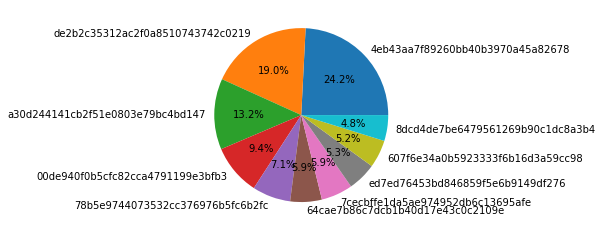

In [731]:
#топ-10 работников по количеству выбросов в static_arousal
print('Количество работников всего =', len(dict_arousal_outliers_s))
print('Количество работников с 0 outlier =', len([k for k, v in dict_arousal_outliers_s.items() if v==0]))
print([i[1] for i in sorted(dict_arousal_outliers_s.items(), key=lambda item: item[1], reverse=True)[:10]])
plt.pie([i[1] for i in sorted(dict_arousal_outliers_s.items(), key=lambda item: item[1], reverse=True)[:10]],labels=[i[0] for i in sorted(dict_arousal_outliers_s.items(), key=lambda item: item[1], reverse=True)[:10]],autopct= '%1.1f%%')
plt.show()

Количество работников всего = 187
Количество работников с 0 outlier = 153
[83, 68, 39, 29, 26, 22, 19, 12, 12, 9]


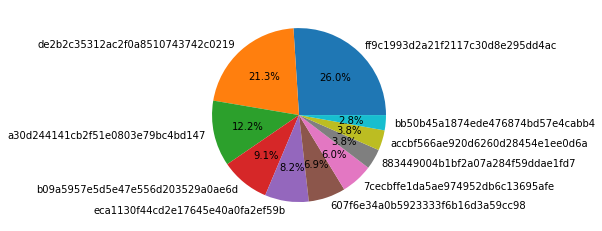

In [732]:
#топ-10 работников по количеству выбросов в  dynamic_valence
print('Количество работников всего =', len(dict_valence_outliers_d))
print('Количество работников с 0 outlier =', len([k for k, v in dict_valence_outliers_d.items() if v==0]))
print([i[1] for i in sorted(dict_valence_outliers_d.items(), key=lambda item: item[1], reverse=True)[:10]])
plt.pie([i[1] for i in sorted(dict_valence_outliers_d.items(), key=lambda item: item[1], reverse=True)[:10]],labels=[i[0] for i in sorted(dict_valence_outliers_d.items(), key=lambda item: item[1], reverse=True)[:10]],autopct= '%1.1f%%')
plt.show()

Количество работников всего = 187
Количество работников с 0 outlier = 149
[138, 69, 66, 32, 28, 24, 14, 13, 7, 7]


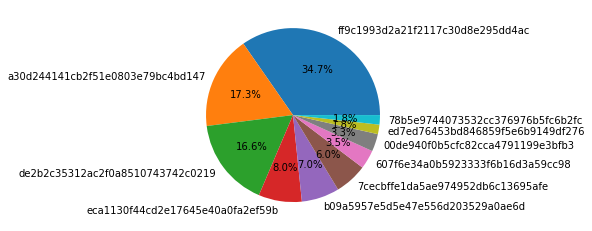

In [733]:
#топ-10 работников по количеству выбросов в dynamic_arousal
print('Количество работников всего =', len(dict_arousal_outliers_d))
print('Количество работников с 0 outlier =', len([k for k, v in dict_arousal_outliers_d.items() if v==0]))
print([i[1] for i in sorted(dict_arousal_outliers_d.items(), key=lambda item: item[1], reverse=True)[:10]])
plt.pie([i[1] for i in sorted(dict_arousal_outliers_d.items(), key=lambda item: item[1], reverse=True)[:10]],labels=[i[0] for i in sorted(dict_arousal_outliers_d.items(), key=lambda item: item[1], reverse=True)[:10]],autopct= '%1.1f%%')
plt.show()

[423, 253, 244, 210, 108, 102, 89, 87, 79, 75, 70, 51, 45, 40, 39, 37, 33, 32, 32, 31, 30, 26, 26, 26, 23, 22, 20, 18, 17, 17, 16, 14, 13, 11, 10, 10, 10, 10, 9, 9, 8, 8, 7, 6, 6, 6, 6, 6, 6, 5, 5, 5, 5, 5, 4, 4, 4, 4, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


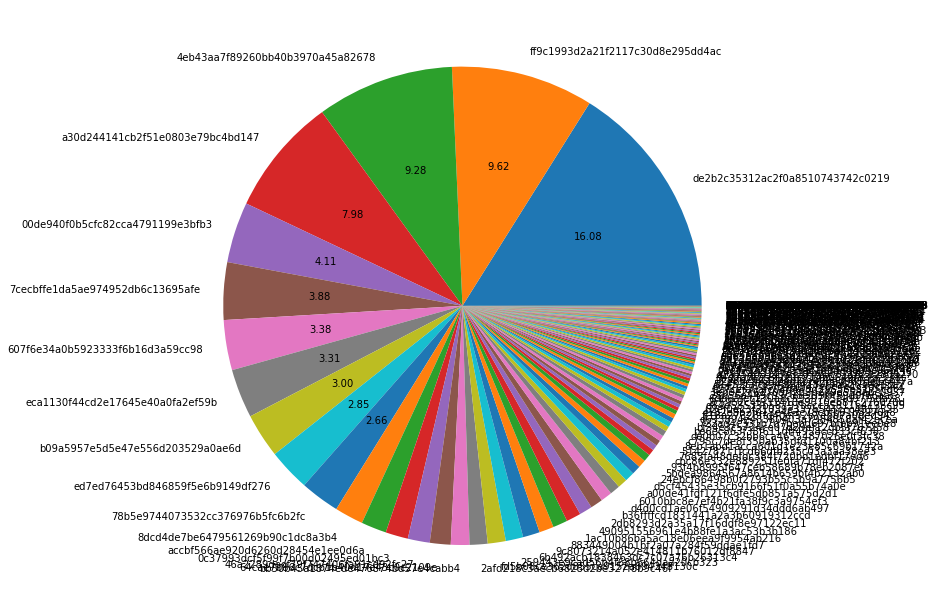

In [734]:
#Диаграмма, содержащая долю выбросов в данных 2014 года на каждого работника
fig, ax = plt.subplots(figsize=(11,11))
dict_all_outliers = {k : dict_arousal_outliers_d.get(k,0)+dict_arousal_outliers_s.get(k,0)+dict_valence_outliers_d.get(k,0)+dict_valence_outliers_s.get(k,0) for k in set(dict_valence_outliers_s)|set(dict_valence_outliers_d)|set(dict_arousal_outliers_s)|set(dict_arousal_outliers_d)}
print([i[1] for i in sorted(dict_all_outliers.items(), key=lambda item: item[1], reverse=True)])
plt.pie([i[1] for i in sorted(dict_all_outliers.items(), key=lambda item: item[1], reverse=True)],labels=[i[0] for i in sorted(dict_all_outliers.items(), key=lambda item: item[1], reverse=True)],autopct=lambda p: format(p, '.2f') if p > 2.5 else None)
plt.show()

In [735]:
#данные 2015 статика
df_static_annotations_songs_2000_2058 = pd.read_csv('audio_data/DEAM_Annotations/annotations/annotations per each rater/song_level/static_annotations_songs_2000_2058.csv')
df_static_annotations_songs_2000_2058.head(5)

,SongId,WorkerId,Arousal_Average,Valence_Average,Arousal_Maximum,Valence_Maximum,Arousal_Minimum,Valence_Minimum
0,2001,523edc3414996c8e52eb14f20c93fe96,7,3,8,7,2,2
1,2001,ae0b751438f08bb474e5cd3e48e0d417,5,3,9,3,3,2
2,2001,fd4cc3ae7434a18286204f133b490502,7,3,8,5,4,2
3,2001,58af5138dd2f00af1f52d2c2c031f4a2,7,2,9,4,5,1
4,2001,3c960e4e5a02213fc82b98b770a0663c,7,5,9,6,3,4


In [736]:
#данные 2015 динамика для 2001 песни
df_dynamic_valence_2001 = pd.read_csv('audio_data/DEAM_Annotations/annotations/annotations per each rater/dynamic (per second annotations)/valence/2001.csv')
df_dynamic_valence_2001

,WorkerId,sample_15000ms,sample_15500ms,sample_16000ms,sample_16500ms,sample_17000ms,sample_17500ms,sample_18000ms,sample_18500ms,sample_19000ms,...,sample_296000ms,sample_296500ms,sample_297000ms,sample_297500ms,sample_298000ms,sample_298500ms,sample_299000ms,sample_299500ms,sample_300000ms,sample_300500ms
0,883449004b1bf2a07a284f59ddae1fd7,0.10,0.10,0.10,0.10,0.07,0.04,0.04,0.04,0.04,...,-0.63,-0.64,-0.64,-0.62,-0.59,-0.52,-0.49,-0.48,-0.43,-0.43
1,b09a5957e5d5e47e556d203529a0ae6d,-0.07,-0.08,-0.08,-0.08,-0.08,-0.08,-0.10,-0.13,-0.16,...,-0.87,-0.87,-0.87,-0.87,-0.87,-0.87,-0.87,-0.87,-0.87,-0.87
2,a8d14f76676af36b8978406be47c0c38,0.07,0.07,0.07,0.07,0.08,0.08,0.08,0.08,0.08,...,-0.43,-0.41,-0.39,-0.34,-0.28,-0.23,-0.15,-0.12,-0.10,-0.06
3,02bf7a99a5e47f4d52939ab7efc8a549,-0.60,-0.60,-0.60,-0.57,-0.54,-0.54,-0.49,-0.49,-0.46,...,-0.75,-0.94,-0.95,-0.98,-0.96,-0.96,-0.96,-0.82,-0.66,-0.63
4,467b1ff3ccfff51e2882bd9d39ef2082,-0.03,-0.03,-0.03,-0.03,-0.03,-0.03,-0.03,-0.03,-0.03,...,-0.01,-0.01,-0.01,-0.01,-0.01,-0.01,-0.01,0.00,0.00,0.00


In [737]:
#количество измерений который сделал каждый работник в 2013 и 2014 статика
dict_workers_freq_s = {}
dict_workers_freq_s = dict_workers_freq_s.fromkeys(df_static_annotations_songs_1_2000['workerID'].unique(), 0)
for i in df_static_annotations_songs_1_2000.index:
    dict_workers_freq_s[df_static_annotations_songs_1_2000.loc[i]['workerID']]+=1
dict_workers_freq_s

{'6010bbc8e7ef4b21fa38f9c3a9754ef3': 396,
 '3c888e77b992ae3cd2adfe16774e23b9': 11,
 '2afd218c3aecb6828d2be327f8b9c46f': 760,
 'fd5b08ce362d855ca9152a894348130c': 222,
 '9c8073214a052e414811b76012df8847': 160,
 '6b492acb1838463dc7c07a76b26313c4': 247,
 '8dcd4de7be6479561269b90c1dc8a3b4': 454,
 'cbc86e332e889251fe0fa71df472f202': 151,
 '259443e9cad56b4f68b664daa20cb323': 305,
 '5bf3c29fd496e2cafa9c531c7e9c6d61': 29,
 'bf34e3c5724ce07d29ef12db5f767258': 249,
 '514278711fcdb6dfb235c03a3aa38ee3': 269,
 '4eb43aa7f89260bb40b3970a45a82678': 333,
 'ed7ed76453bd846859f5e6b9149df276': 675,
 '571d66ea4abfb694d9bb1281d7701710': 68,
 'd84d58533b58797bccca5811b4135c95': 31,
 '490951556961e4b88fe1a3ac53b3b186': 313,
 '2c5952c4f931410e9010eb87c276020d': 73,
 '0c37993dcf5f99f7b00d02495ed01bc3': 339,
 '64cae7b86c7dcb1b40d17e43c0c2109e': 365,
 '24ebcf86498b0f2793b55c5b9a7756b5': 210,
 '94d7a0f7c8f2e1c714b0649f835c538c': 150,
 'a00de41fdf121f6dfe5db851a575d2d1': 146,
 '7cecbffe1da5ae974952db6c13695afe': 42

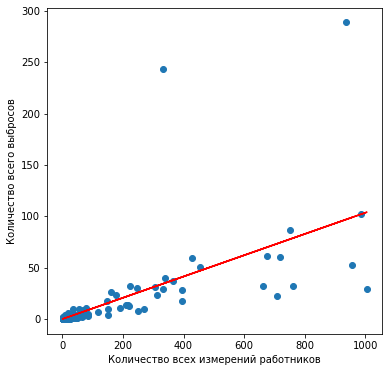

In [738]:
#связь частоты и количества выбросов в 2013 и 2014 статика
fig, ax = plt.subplots(figsize=(6,6))
dict_all_outliers_s = {k : dict_arousal_outliers_s.get(k,0)+dict_valence_outliers_s.get(k,0) for k in set(dict_valence_outliers_s)|set(dict_arousal_outliers_s)}
array_freq =[]
array_outliers =[]
for k,v in dict_all_outliers_s.items():
    array_freq.append(dict_workers_freq_s[k])
    array_outliers.append(dict_all_outliers_s[k])
plt.scatter(x=array_freq,y=array_outliers)
plt.xlabel('Количество всех измерений работников')
plt.ylabel('Количество всего выбросов')
m, b = np.polyfit(array_freq, array_outliers, 1)
plt.plot(np.array(array_freq),m*np.array(array_freq)+b,color='r')
#print([i[0] for i in dict_all_outliers.items()],'\n')
#print([i[0] for i in dict_workers_freq_s.items()])
plt.show()

In [739]:
#частота работников в arousal и valence 2014 динамика
dict_worker_freq_ar_d={}
dict_worker_freq_val_d={}
dict_worker_freq_ar_d=dict_worker_freq_ar_d.fromkeys(df_static_annotations_songs_1_2000['workerID'].unique(), 0)
dict_worker_freq_val_d=dict_worker_freq_val_d.fromkeys(df_static_annotations_songs_1_2000['workerID'].unique(), 0)

for i in df_metadata_2014['Id']:
    df_arousal_d = pd.read_csv(glob.glob(directory + '/arousal/' + str(i) + '.csv')[0])
    if ('WorkerId' in df_arousal_d.columns):
        for j in df_arousal_d['WorkerId']:
            dict_worker_freq_ar_d[j]+=1
    df_valence_d = pd.read_csv(glob.glob(directory + '/valence/' + str(i) + '.csv')[0])
    if ('WorkerId' in df_valence_d.columns):
        for j in df_valence_d['WorkerId']:
            dict_worker_freq_val_d[j]+=1

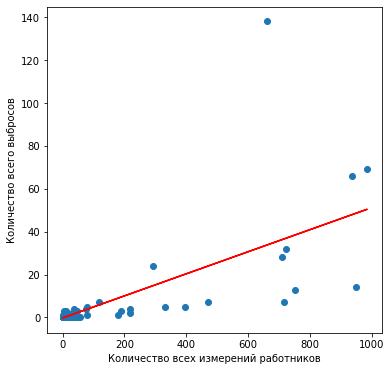

In [740]:
#связь частоты и количества выбросов в 2014 динамика для arousal
fig, ax = plt.subplots(figsize=(6,6))
array_freq =[]
array_outliers =[]
for k,v in dict_arousal_outliers_d.items():
    array_freq.append(dict_worker_freq_ar_d[k])
    array_outliers.append(dict_arousal_outliers_d[k])
plt.scatter(x=array_freq,y=array_outliers)
plt.xlabel('Количество всех измерений работников')
plt.ylabel('Количество всего выбросов')
#print([i[0] for i in dict_all_outliers.items()],'\n')
#print([i[0] for i in dict_workers_freq_s.items()])
m, b = np.polyfit(array_freq, array_outliers, 1)
plt.plot(np.array(array_freq),m*np.array(array_freq)+b,color='r')
plt.show()

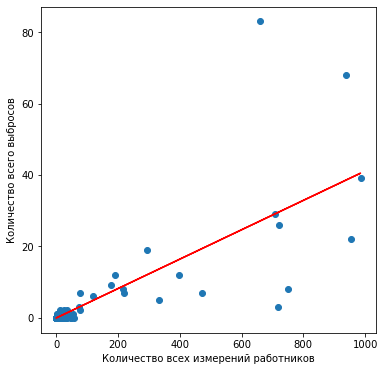

In [741]:
#связь частоты и количества выбросов в 2014 динамика для valence
fig, ax = plt.subplots(figsize=(6,6))
array_freq =[]
array_outliers =[]
for k,v in dict_valence_outliers_d.items():
    array_freq.append(dict_worker_freq_val_d[k])
    array_outliers.append(dict_valence_outliers_d[k])
plt.scatter(x=array_freq,y=array_outliers)
plt.xlabel('Количество всех измерений работников')
plt.ylabel('Количество всего выбросов')
#print([i[0] for i in dict_all_outliers.items()],'\n')
#print([i[0] for i in dict_workers_freq_s.items()])
m, b = np.polyfit(array_freq, array_outliers, 1)
plt.plot(np.array(array_freq),m*np.array(array_freq)+b,color='r')
plt.show()

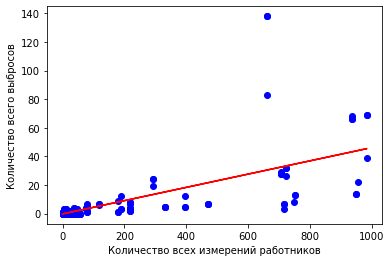

In [742]:
#связь частоты и количества выбросов в 2014 динамика

array_freq =[]
array_outliers =[]
for k,v in dict_arousal_outliers_d.items():
    array_freq.append(dict_worker_freq_ar_d[k])
    array_outliers.append(dict_arousal_outliers_d[k])
plt.scatter(x=array_freq,y=array_outliers,color='b')
plt.xlabel('Количество всех измерений работников')
plt.ylabel('Количество всего выбросов')
#print([i[0] for i in dict_all_outliers.items()],'\n')
#print([i[0] for i in dict_workers_freq_s.items()])

array_freq_2 = []
array_outliers_2 =[]
for k,v in dict_valence_outliers_d.items():
    array_freq_2.append(dict_worker_freq_val_d[k])
    array_outliers_2.append(dict_valence_outliers_d[k])
array_freq = array_freq + array_freq_2
array_outliers = array_outliers+array_outliers_2
plt.scatter(x=array_freq,y=array_outliers,color='b')
plt.xlabel('Количество всех измерений работников')
plt.ylabel('Количество всего выбросов')
#print(array_freq)
#print([i[0] for i in dict_all_outliers.items()],'\n')
#print([i[0] for i in dict_workers_freq_s.items()])
m, b = np.polyfit(array_freq, array_outliers, 1)
plt.plot(np.array(array_freq),m*np.array(array_freq)+b,color='r')
plt.show()

In [743]:
#анализ выбросов для данных 2015

df_metadata_2015 = pd.read_csv('audio_data/metadata/metadata_2015.csv',usecols=['id','Filename','title','artist','album','genre'])
df_metadata_2015.head()

,id,Filename,title,artist,album,genre
0,2001,Creepoid_OldTree,Old Tree,Creepoid,NaN,Rock
1,2002,AmarLal_SpringDay1,Spring Day 1,Amar Lal,NaN,Singer/Songwriter
2,2003,JoelHelander_ExcessiveResistancetoChange,Excessive Resistance to Change,Joel Helander,NaN,Classical
3,2004,AimeeNorwich_Flying,Flying,Aimee Norwich,NaN,World/Folk
4,2005,AvaLuna_Waterduct,Waterduct,Ava Luna,NaN,Rock


In [744]:
#все работники оценивающие динамику
directory = 'audio_data/DEAM_Annotations/annotations/annotations per each rater/dynamic (per second annotations)'
workers_arousal = pd.Series()
workers_valence = pd.Series()
for i in df_metadata_2015['id']:
    df_arousal_d = pd.read_csv(glob.glob(directory + '/arousal/' + str(i) + '.csv')[0])
    workers_arousal = pd.concat([workers_arousal,df_arousal_d['WorkerId']], axis=0)
    df_valence_d = pd.read_csv(glob.glob(directory + '/valence/' + str(i) + '.csv')[0])
    workers_valence = pd.concat([workers_valence,df_valence_d['WorkerId']], axis=0)
workers_arousal_2015 = workers_arousal.unique()
workers_valence_2015 = workers_valence.unique()
dict_worker_freq_ar_d_2015 = {}
dict_worker_freq_ar_d_2015 = dict_worker_freq_ar_d_2015.fromkeys(workers_arousal_2015, 0)
dict_worker_freq_val_d_2015 = {}
dict_worker_freq_val_d_2015 = dict_worker_freq_val_d_2015.fromkeys(workers_valence_2015, 0)
for i in df_metadata_2015['id']:
    df_arousal_d = pd.read_csv(glob.glob(directory + '/arousal/' + str(i) + '.csv')[0])
    for j in df_arousal_d['WorkerId']:
        dict_worker_freq_ar_d_2015[j]+=1
    df_valence_d = pd.read_csv(glob.glob(directory + '/valence/' + str(i) + '.csv')[0])
    for j in df_valence_d['WorkerId']:
        dict_worker_freq_val_d_2015[j]+=1

C:\Users\0D04~1\AppData\Local\Temp/ipykernel_20668/64907381.py:3: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  workers_arousal = pd.Series()
C:\Users\0D04~1\AppData\Local\Temp/ipykernel_20668/64907381.py:4: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  workers_valence = pd.Series()


In [745]:
#подсчитывание выбросов для динамики arousal и valence
dict_arousal_outliers_d_2015 = {}
dict_arousal_outliers_d_2015 = dict_arousal_outliers_d_2015.fromkeys(workers_arousal_2015, 0)
dict_valence_outliers_d_2015 = {}
dict_valence_outliers_d_2015 = dict_valence_outliers_d_2015.fromkeys(workers_valence_2015, 0)

directory = 'audio_data/DEAM_Annotations/annotations/annotations per each rater/dynamic (per second annotations)'

for i in df_metadata_2015['id']:
    df_arousal_d = pd.read_csv(glob.glob(directory + '/arousal/' + str(i) + '.csv')[0])
    #print(i)
    #print(df_arousal_d)
    index_series = df_arousal_d['WorkerId']
    df_arousal_d_mean = df_arousal_d.drop('WorkerId', axis=1).T.describe().T['mean']
    #print(df_arousal_d_mean)
    #print(index_series)
    df_arousal_d_mean = df_arousal_d_mean.set_axis(index_series)
    #print(df_arousal_d_mean)
    ######
    outliers_arousal_d = find_outliers(df_arousal_d_mean)
    #print(outliers_arousal_d)
    for j in outliers_arousal_d.index:
        dict_arousal_outliers_d_2015[j]+=1
    df_valence_d = pd.read_csv(glob.glob(directory + '/valence/' + str(i) + '.csv')[0])
    #print(i)
    #print(df_valence_d)
    df_valence_d_mean = df_valence_d.drop('WorkerId', axis=1).T.describe().T['mean']
    index_series = df_valence_d['WorkerId']
    #print(df_valence_d_mean)
    #print(index_series)
    df_valence_d_mean = df_valence_d_mean.set_axis(index_series)
    #print(df_valence_d_mean)
    #####
    outliers_valence_d = find_outliers(df_valence_d_mean)
    #print(outliers_valence_d)
    for j in outliers_valence_d.index:
        dict_valence_outliers_d_2015[j]+=1
        
print(dict_arousal_outliers_d_2015,'\n')
print(dict_valence_outliers_d_2015)

{'883449004b1bf2a07a284f59ddae1fd7': 1, 'b09a5957e5d5e47e556d203529a0ae6d': 18, 'a8d14f76676af36b8978406be47c0c38': 5, '02bf7a99a5e47f4d52939ab7efc8a549': 2, '467b1ff3ccfff51e2882bd9d39ef2082': 0, 'e692af6e00f4a7d14933fd23058998ca': 2, '4874e802dab1e5f13ee4da6403f40d68': 1, '5c71ac012aadbd3491d3cc2a6b52afaa': 1} 

{'883449004b1bf2a07a284f59ddae1fd7': 3, 'b09a5957e5d5e47e556d203529a0ae6d': 4, 'a8d14f76676af36b8978406be47c0c38': 2, '02bf7a99a5e47f4d52939ab7efc8a549': 1, '467b1ff3ccfff51e2882bd9d39ef2082': 0, 'e692af6e00f4a7d14933fd23058998ca': 4, '4874e802dab1e5f13ee4da6403f40d68': 4}


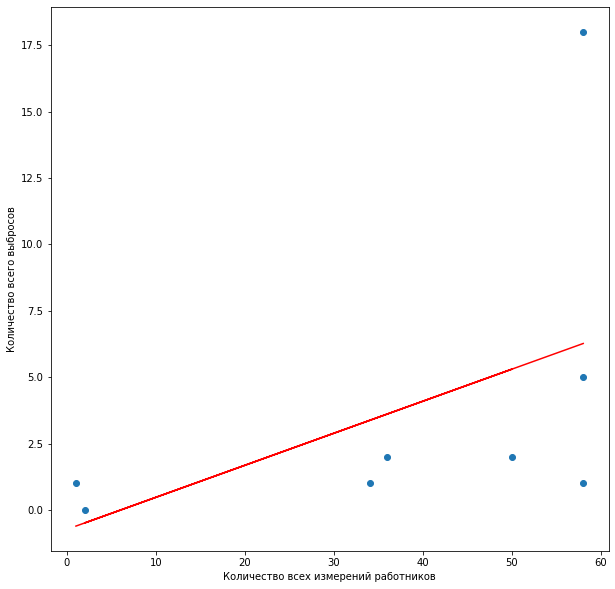

In [746]:
#связь частоты и количества выбросов в 2015 динамика для arousal
fig, ax = plt.subplots(figsize=(10,10))
array_freq =[]
array_outliers =[]
for k,v in dict_arousal_outliers_d_2015.items():
    array_freq.append(dict_worker_freq_ar_d_2015[k])
    array_outliers.append(dict_arousal_outliers_d_2015[k])
plt.scatter(x=array_freq,y=array_outliers)
plt.xlabel('Количество всех измерений работников')
plt.ylabel('Количество всего выбросов')
#print([i[0] for i in dict_all_outliers.items()],'\n')
#print([i[0] for i in dict_workers_freq_s.items()])
m, b = np.polyfit(array_freq, array_outliers, 1)
plt.plot(np.array(array_freq),m*np.array(array_freq)+b,color='r')
plt.show()

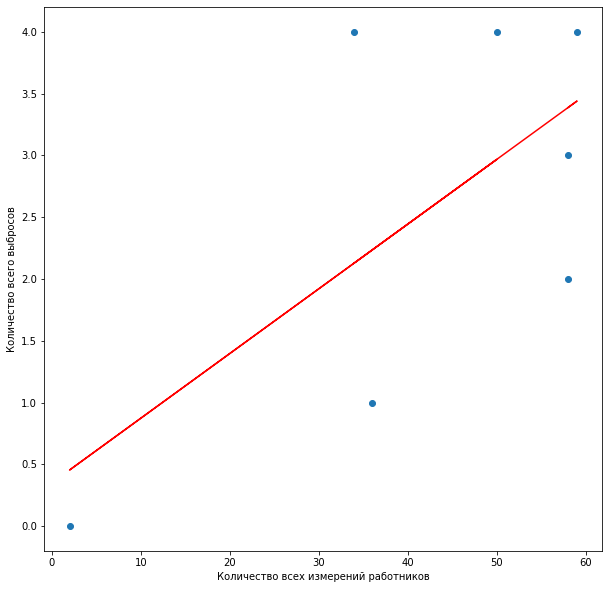

In [747]:
#связь частоты и количества выбросов в 2015 динамика для valence
fig, ax = plt.subplots(figsize=(10,10))
array_freq =[]
array_outliers =[]
for k,v in dict_valence_outliers_d_2015.items():
    array_freq.append(dict_worker_freq_val_d_2015[k])
    array_outliers.append(dict_valence_outliers_d_2015[k])
plt.scatter(x=array_freq,y=array_outliers)
plt.xlabel('Количество всех измерений работников')
plt.ylabel('Количество всего выбросов')
#print([i[0] for i in dict_all_outliers.items()],'\n')
#print([i[0] for i in dict_workers_freq_s.items()])
m, b = np.polyfit(array_freq, array_outliers, 1)
plt.plot(np.array(array_freq),m*np.array(array_freq)+b,color='r')
plt.show()

In [748]:
#все работники оценивающие статику
workers_static = df_static_annotations_songs_2000_2058[' WorkerId'].unique()
workers_static

array(['523edc3414996c8e52eb14f20c93fe96',
       'ae0b751438f08bb474e5cd3e48e0d417',
       'fd4cc3ae7434a18286204f133b490502',
       '58af5138dd2f00af1f52d2c2c031f4a2',
       '3c960e4e5a02213fc82b98b770a0663c',
       '949fcd0caf9d4b51a280acfbcd5e8e80',
       'b8bc7171b9ff0de8aaed0bf210fb711c',
       'b4cad77b1093f7d134c6c141af4dddad'], dtype=object)

In [749]:
#подсчёт выбросов для данных 2015 года
dict_arousal_av_outliers_s_2015 = {}
dict_valence_av_outliers_s_2015 = {}
dict_arousal_max_outliers_s_2015 = {}
dict_valence_max_outliers_s_2015 = {}
dict_arousal_min_outliers_s_2015 = {}
dict_valence_min_outliers_s_2015 = {}
dict_arousal_av_outliers_s_2015 = dict_arousal_av_outliers_s_2015.fromkeys(workers_static, 0)
dict_valence_av_outliers_s_2015 = dict_valence_av_outliers_s_2015.fromkeys(workers_static, 0)
dict_arousal_max_outliers_s_2015 = dict_arousal_max_outliers_s_2015.fromkeys(workers_static, 0)
dict_valence_max_outliers_s_2015 = dict_valence_max_outliers_s_2015.fromkeys(workers_static, 0)
dict_arousal_min_outliers_s_2015 = dict_arousal_min_outliers_s_2015.fromkeys(workers_static, 0)
dict_valence_min_outliers_s_2015 = dict_valence_min_outliers_s_2015.fromkeys(workers_static, 0)

for i in df_metadata_2015['id']:
    outliers_arousal_av_outliers_s_2015 = find_outliers(df_static_annotations_songs_2000_2058[df_static_annotations_songs_2000_2058['SongId'] == i][' Arousal_Average'])
    for j in outliers_arousal_av_outliers_s_2015.index:
        dict_arousal_av_outliers_s_2015[df_static_annotations_songs_2000_2058[df_static_annotations_songs_2000_2058['SongId'] == i].loc[j][' WorkerId']]+=1
    outliers_valence_av_outliers_s_2015 = find_outliers(df_static_annotations_songs_2000_2058[df_static_annotations_songs_2000_2058['SongId'] == i][' Valence_Average'])
    for j in outliers_valence_av_outliers_s_2015.index:
        dict_valence_av_outliers_s_2015[df_static_annotations_songs_2000_2058[df_static_annotations_songs_2000_2058['SongId'] == i].loc[j][' WorkerId']]+=1
    outliers_arousal_max_outliers_s_2015 = find_outliers(df_static_annotations_songs_2000_2058[df_static_annotations_songs_2000_2058['SongId'] == i][' Arousal_Maximum'])
    for j in outliers_arousal_max_outliers_s_2015.index:
        dict_arousal_max_outliers_s_2015[df_static_annotations_songs_2000_2058[df_static_annotations_songs_2000_2058['SongId'] == i].loc[j][' WorkerId']]+=1
    outliers_valence_max_outliers_s_2015 = find_outliers(df_static_annotations_songs_2000_2058[df_static_annotations_songs_2000_2058['SongId'] == i][' Valence_Maximum'])
    for j in outliers_valence_max_outliers_s_2015.index:
        dict_valence_max_outliers_s_2015[df_static_annotations_songs_2000_2058[df_static_annotations_songs_2000_2058['SongId'] == i].loc[j][' WorkerId']]+=1
    outliers_arousal_min_outliers_s_2015 = find_outliers(df_static_annotations_songs_2000_2058[df_static_annotations_songs_2000_2058['SongId'] == i][' Arousal_Minimum'])
    for j in outliers_arousal_min_outliers_s_2015.index:
        dict_arousal_min_outliers_s_2015[df_static_annotations_songs_2000_2058[df_static_annotations_songs_2000_2058['SongId'] == i].loc[j][' WorkerId']]+=1
    outliers_valence_min_outliers_s_2015 = find_outliers(df_static_annotations_songs_2000_2058[df_static_annotations_songs_2000_2058['SongId'] == i][' Valence_Minimum'])
    for j in outliers_valence_min_outliers_s_2015.index:
        dict_valence_min_outliers_s_2015[df_static_annotations_songs_2000_2058[df_static_annotations_songs_2000_2058['SongId'] == i].loc[j][' WorkerId']]+=1

print(dict_arousal_av_outliers_s_2015,'\n')
print(dict_valence_av_outliers_s_2015,'\n')
print(dict_arousal_max_outliers_s_2015,'\n')
print(dict_valence_max_outliers_s_2015,'\n')
print(dict_arousal_min_outliers_s_2015,'\n')
print(dict_valence_min_outliers_s_2015)

{'523edc3414996c8e52eb14f20c93fe96': 6, 'ae0b751438f08bb474e5cd3e48e0d417': 3, 'fd4cc3ae7434a18286204f133b490502': 5, '58af5138dd2f00af1f52d2c2c031f4a2': 1, '3c960e4e5a02213fc82b98b770a0663c': 0, '949fcd0caf9d4b51a280acfbcd5e8e80': 1, 'b8bc7171b9ff0de8aaed0bf210fb711c': 0, 'b4cad77b1093f7d134c6c141af4dddad': 0} 

{'523edc3414996c8e52eb14f20c93fe96': 2, 'ae0b751438f08bb474e5cd3e48e0d417': 4, 'fd4cc3ae7434a18286204f133b490502': 3, '58af5138dd2f00af1f52d2c2c031f4a2': 3, '3c960e4e5a02213fc82b98b770a0663c': 1, '949fcd0caf9d4b51a280acfbcd5e8e80': 5, 'b8bc7171b9ff0de8aaed0bf210fb711c': 4, 'b4cad77b1093f7d134c6c141af4dddad': 0} 

{'523edc3414996c8e52eb14f20c93fe96': 2, 'ae0b751438f08bb474e5cd3e48e0d417': 3, 'fd4cc3ae7434a18286204f133b490502': 0, '58af5138dd2f00af1f52d2c2c031f4a2': 1, '3c960e4e5a02213fc82b98b770a0663c': 0, '949fcd0caf9d4b51a280acfbcd5e8e80': 1, 'b8bc7171b9ff0de8aaed0bf210fb711c': 0, 'b4cad77b1093f7d134c6c141af4dddad': 0} 

{'523edc3414996c8e52eb14f20c93fe96': 0, 'ae0b751438f08b

In [750]:
#количество измерений работников
dict_worker_freq_s_2015 = {}
dict_worker_freq_s_2015 = dict_worker_freq_s_2015.fromkeys(workers_static, 0)
for i in df_static_annotations_songs_2000_2058.index:
    dict_worker_freq_s_2015[df_static_annotations_songs_2000_2058.loc[i][' WorkerId']]+=1
print(dict_worker_freq_s_2015)

{'523edc3414996c8e52eb14f20c93fe96': 58, 'ae0b751438f08bb474e5cd3e48e0d417': 59, 'fd4cc3ae7434a18286204f133b490502': 58, '58af5138dd2f00af1f52d2c2c031f4a2': 36, '3c960e4e5a02213fc82b98b770a0663c': 2, '949fcd0caf9d4b51a280acfbcd5e8e80': 50, 'b8bc7171b9ff0de8aaed0bf210fb711c': 34, 'b4cad77b1093f7d134c6c141af4dddad': 1}


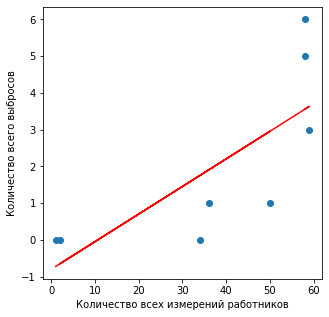

In [751]:
#связь частоты и количества выбросов в 2015 статика для arousal_average
fig, ax = plt.subplots(figsize=(5,5))
array_freq =[]
array_outliers =[]
for k,v in dict_arousal_av_outliers_s_2015.items():
    array_freq.append(dict_worker_freq_s_2015[k])
    array_outliers.append(dict_arousal_av_outliers_s_2015[k])
plt.scatter(x=array_freq,y=array_outliers)
plt.xlabel('Количество всех измерений работников')
plt.ylabel('Количество всего выбросов')
#print([i[0] for i in dict_all_outliers.items()],'\n')
#print([i[0] for i in dict_workers_freq_s.items()])
m, b = np.polyfit(array_freq, array_outliers, 1)
plt.plot(np.array(array_freq),m*np.array(array_freq)+b,color='r')
plt.show()

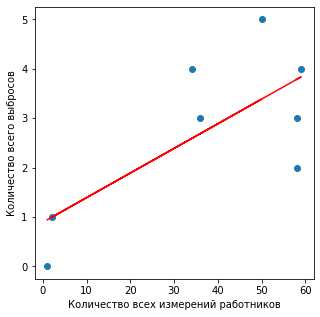

In [752]:
#связь частоты и количества выбросов в 2015 статика для valence_average
fig, ax = plt.subplots(figsize=(5,5))
array_freq =[]
array_outliers =[]
for k,v in dict_valence_av_outliers_s_2015.items():
    array_freq.append(dict_worker_freq_s_2015[k])
    array_outliers.append(dict_valence_av_outliers_s_2015[k])
plt.scatter(x=array_freq,y=array_outliers)
plt.xlabel('Количество всех измерений работников')
plt.ylabel('Количество всего выбросов')
#print([i[0] for i in dict_all_outliers.items()],'\n')
#print([i[0] for i in dict_workers_freq_s.items()])
m, b = np.polyfit(array_freq, array_outliers, 1)
plt.plot(np.array(array_freq),m*np.array(array_freq)+b,color='r')
plt.show()

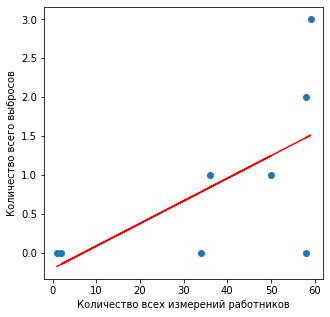

In [753]:
#связь частоты и количества выбросов в 2015 статика для arousal_maximum
fig, ax = plt.subplots(figsize=(5,5))
array_freq =[]
array_outliers =[]
for k,v in dict_arousal_max_outliers_s_2015.items():
    array_freq.append(dict_worker_freq_s_2015[k])
    array_outliers.append(dict_arousal_max_outliers_s_2015[k])
plt.scatter(x=array_freq,y=array_outliers)
plt.xlabel('Количество всех измерений работников')
plt.ylabel('Количество всего выбросов')
#print([i[0] for i in dict_all_outliers.items()],'\n')
#print([i[0] for i in dict_workers_freq_s.items()])
m, b = np.polyfit(array_freq, array_outliers, 1)
plt.plot(np.array(array_freq),m*np.array(array_freq)+b,color='r')
plt.show()

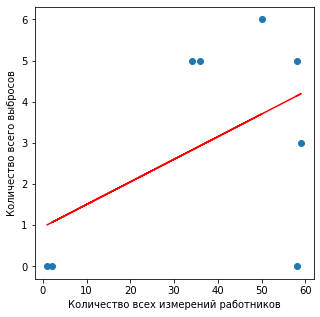

In [754]:
#связь частоты и количества выбросов в 2015 статика для valence_maximum
fig, ax = plt.subplots(figsize=(5,5))
array_freq =[]
array_outliers =[]
for k,v in dict_valence_max_outliers_s_2015.items():
    array_freq.append(dict_worker_freq_s_2015[k])
    array_outliers.append(dict_valence_max_outliers_s_2015[k])
plt.scatter(x=array_freq,y=array_outliers)
plt.xlabel('Количество всех измерений работников')
plt.ylabel('Количество всего выбросов')
#print([i[0] for i in dict_all_outliers.items()],'\n')
#print([i[0] for i in dict_workers_freq_s.items()])
m, b = np.polyfit(array_freq, array_outliers, 1)
plt.plot(np.array(array_freq),m*np.array(array_freq)+b,color='r')
plt.show()

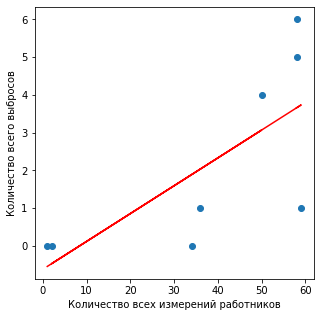

In [755]:
#связь частоты и количества выбросов в 2015 статика для arousal_minimum
fig, ax = plt.subplots(figsize=(5,5))
array_freq =[]
array_outliers =[]
for k,v in dict_arousal_min_outliers_s_2015.items():
    array_freq.append(dict_worker_freq_s_2015[k])
    array_outliers.append(dict_arousal_min_outliers_s_2015[k])
plt.scatter(x=array_freq,y=array_outliers)
plt.xlabel('Количество всех измерений работников')
plt.ylabel('Количество всего выбросов')
#print([i[0] for i in dict_all_outliers.items()],'\n')
#print([i[0] for i in dict_workers_freq_s.items()])
m, b = np.polyfit(array_freq, array_outliers, 1)
plt.plot(np.array(array_freq),m*np.array(array_freq)+b,color='r')
plt.show()

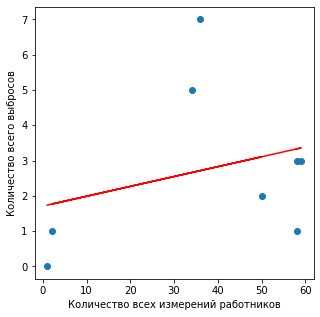

In [756]:
#связь частоты и количества выбросов в 2015 статика для valence_minimum
fig, ax = plt.subplots(figsize=(5,5))
array_freq =[]
array_outliers =[]
for k,v in dict_valence_min_outliers_s_2015.items():
    array_freq.append(dict_worker_freq_s_2015[k])
    array_outliers.append(dict_valence_min_outliers_s_2015[k])
plt.scatter(x=array_freq,y=array_outliers)
plt.xlabel('Количество всех измерений работников')
plt.ylabel('Количество всего выбросов')
#print([i[0] for i in dict_all_outliers.items()],'\n')
#print([i[0] for i in dict_workers_freq_s.items()])
m, b = np.polyfit(array_freq, array_outliers, 1)
plt.plot(np.array(array_freq),m*np.array(array_freq)+b,color='r')
plt.show()

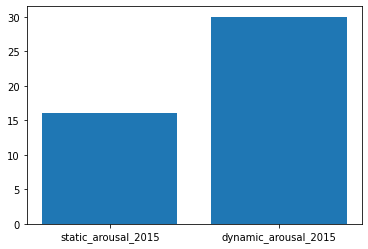

In [757]:
#сравнение количества выбросов в arousal в статике и динамике в 2015
plt.bar(['static_arousal_2015','dynamic_arousal_2015'], [sum(dict_arousal_av_outliers_s_2015.values()),sum(dict_arousal_outliers_d_2015.values())])
plt.show()

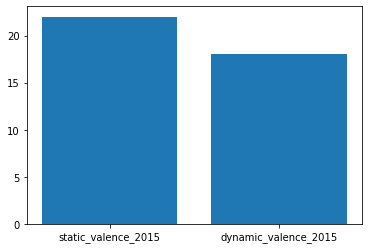

In [758]:
#сравнение количества выбросов в valence в статике и динамике в 2015
plt.bar(['static_valence_2015','dynamic_valence_2015'], [sum(dict_valence_av_outliers_s_2015.values()),sum(dict_valence_outliers_d_2015.values())])
plt.show()

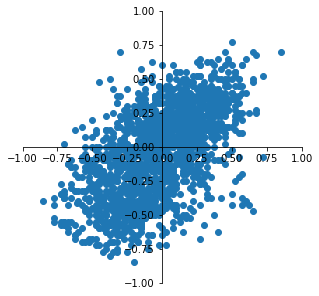

{1: 583, 2: 217, 3: 723, 4: 221}


In [759]:
#график всех песен в 2013-2014 годах построенный по arousal и valence статика
fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(1, 1, 1)

ax.spines['left'].set_position('center')
ax.spines['bottom'].set_position('center')
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')
plt.scatter(y=normilize(df_static_averaged_1_2000[' arousal_mean']),x=normilize(df_static_averaged_1_2000[' valence_mean']))
plt.xlim(-1, 1)
plt.ylim(-1, 1)
plt.show()

dict_quarters_s ={1:0,2:0,3:0,4:0}

for i in df_static_averaged_1_2000.index:
    arousal = normilize(df_static_averaged_1_2000.loc[i][' arousal_mean'])
    valence = normilize(df_static_averaged_1_2000.loc[i][' valence_mean'])
    #print(arousal, valence)
    if ((arousal>0) and (valence>0)):
        dict_quarters_s[1]+=1
    if ((arousal>0) and (valence<=0)):
        dict_quarters_s[2]+=1
    if ((arousal<=0) and (valence<=0)):
        dict_quarters_s[3]+=1
    if ((arousal<=0) and (valence>0)):
        dict_quarters_s[4]+=1
        
print(dict_quarters_s)

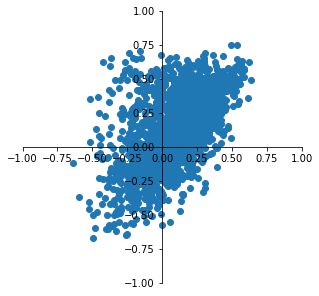

{1: 954, 2: 220, 3: 374, 4: 196}


In [760]:
#график всех песен в 2013-2014 годах построенный по arousal и valence динамика
fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(1, 1, 1)

ax.spines['left'].set_position('center')
ax.spines['bottom'].set_position('center')
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')
plt.scatter(y=df_dynamic_arousal.loc[1:2000].T.describe().T['mean'], x=df_dynamic_valence.loc[1:2000].T.describe().T['mean'])
plt.xlim(-1, 1)
plt.ylim(-1, 1)
plt.show()

dict_quarters_d={1:0,2:0,3:0,4:0}

for i in set(df_dynamic_arousal.loc[1:2000].index):
    arousal = df_dynamic_arousal.loc[i].T.describe().T['mean']
    valence = df_dynamic_valence.loc[i].T.describe().T['mean']
    #print(arousal, valence)
    if ((arousal>0) and (valence>0)):
        dict_quarters_d[1]+=1
    if ((arousal>0) and (valence<=0)):
        dict_quarters_d[2]+=1
    if ((arousal<=0) and (valence<=0)):
        dict_quarters_d[3]+=1
    if ((arousal<=0) and (valence>0)):
        dict_quarters_d[4]+=1
        
print(dict_quarters_d)

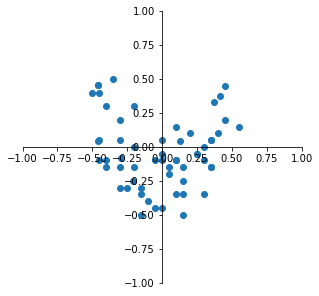

{1: 11, 2: 12, 3: 19, 4: 16}


In [761]:
#график всех песен в 2015 построенный по arousal и valence статика
fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(1, 1, 1)

ax.spines['left'].set_position('center')
ax.spines['bottom'].set_position('center')
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')
plt.scatter(y=normilize(df_static_averaged_2000_2058[' arousal_mean']), x=normilize(df_static_averaged_2000_2058[' valence_mean']))
plt.xlim(-1, 1)
plt.ylim(-1, 1)
plt.show()

dict_quarters_s_2015 ={1:0,2:0,3:0,4:0}

for i in df_static_averaged_2000_2058.index:
    arousal = normilize(df_static_averaged_2000_2058.loc[i][' arousal_mean'])
    valence = normilize(df_static_averaged_2000_2058.loc[i][' valence_mean'])
    #print(arousal, valence)
    if ((arousal>0) and (valence>0)):
        dict_quarters_s_2015[1]+=1
    if ((arousal>0) and (valence<=0)):
        dict_quarters_s_2015[2]+=1
    if ((arousal<=0) and (valence<=0)):
        dict_quarters_s_2015[3]+=1
    if ((arousal<=0) and (valence>0)):
        dict_quarters_s_2015[4]+=1
        
print(dict_quarters_s_2015)

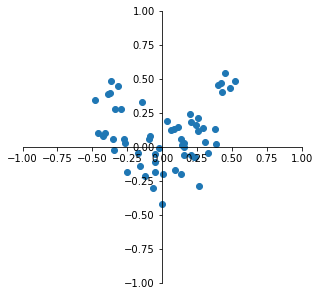

{1: 23, 2: 16, 3: 11, 4: 9}


In [762]:
#график всех песен в 2015 построенный по arousal и valence динамика
fig = plt.figure(figsize=(5,5))
ax = fig.add_subplot(1, 1, 1)

ax.spines['left'].set_position('center')
ax.spines['bottom'].set_position('center')
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')
plt.scatter(y=df_dynamic_arousal.loc[2000:2058].T.describe().T['mean'], x=df_dynamic_valence.loc[2000:2058].T.describe().T['mean'])
plt.xlim(-1, 1)
plt.ylim(-1, 1)
plt.show()

dict_quarters_d_2015={1:0,2:0,3:0,4:0}

for i in set(df_dynamic_arousal.loc[2000:2058].index):
    arousal = df_dynamic_arousal.loc[i].T.describe().T['mean']
    valence = df_dynamic_valence.loc[i].T.describe().T['mean']
    #print(arousal, valence)
    if ((arousal>0) and (valence>0)):
        dict_quarters_d_2015[1]+=1
    if ((arousal>0) and (valence<=0)):
        dict_quarters_d_2015[2]+=1
    if ((arousal<=0) and (valence<=0)):
        dict_quarters_d_2015[3]+=1
    if ((arousal<=0) and (valence>0)):
        dict_quarters_d_2015[4]+=1
        
print(dict_quarters_d_2015)

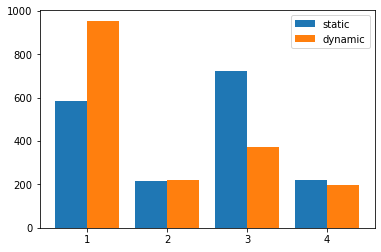

In [763]:
#сравнение количества песен, попавших в одну четверть, 2013-2014
X=dict_quarters_s.keys()

X_axis = np.arange(len(X)) 
  
plt.bar(X_axis - 0.2, dict_quarters_s.values(), 0.4, label = 'static') 
plt.bar(X_axis + 0.2, dict_quarters_d.values(), 0.4, label = 'dynamic')
plt.xticks(X_axis, X) 
plt.legend() 
plt.show() 

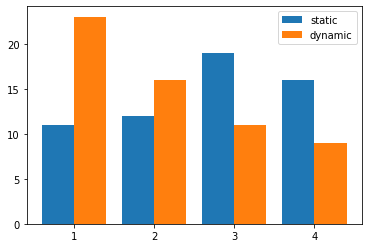

In [764]:
#сравнение количества песен, попавших в одну четверть, 2015
X=dict_quarters_s.keys()

X_axis = np.arange(len(X)) 
  
plt.bar(X_axis - 0.2, dict_quarters_s_2015.values(), 0.4, label = 'static') 
plt.bar(X_axis + 0.2, dict_quarters_d_2015.values(), 0.4, label = 'dynamic')
plt.xticks(X_axis, X) 
plt.legend() 
plt.show() 

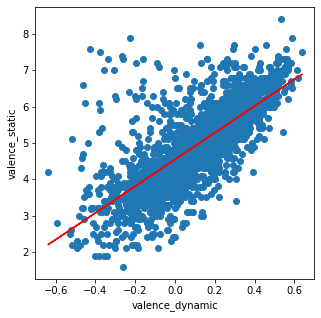

In [765]:
#связь valence_dynamic и valence_static
fig, ax = plt.subplots(figsize=(5,5))
X = df_dynamic_valence.T.describe().T['mean']
Y = pd.concat([df_static_averaged_1_2000[' valence_mean'],df_static_averaged_2000_2058[' valence_mean']])
plt.scatter(X,Y)
plt.xlabel('valence_dynamic')
plt.ylabel('valence_static')
#print([i[0] for i in dict_all_outliers.items()],'\n')
#print([i[0] for i in dict_workers_freq_s.items()])
m, b = np.polyfit(X, Y, 1)
plt.plot(np.array(X),m*np.array(X)+b,color='r')
plt.show()

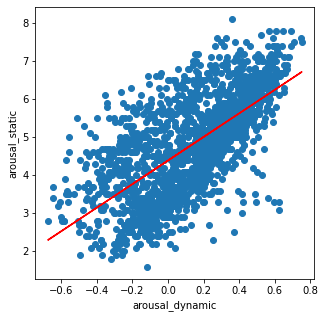

In [766]:
#связь arousal_dynamic и arousal_static
fig, ax = plt.subplots(figsize=(5,5))
X = df_dynamic_arousal.T.describe().T['mean']
Y = pd.concat([df_static_averaged_1_2000[' arousal_mean'],df_static_averaged_2000_2058[' arousal_mean']])
plt.scatter(X,Y)
plt.xlabel('arousal_dynamic')
plt.ylabel('arousal_static')
#print([i[0] for i in dict_all_outliers.items()],'\n')
#print([i[0] for i in dict_workers_freq_s.items()])
m, b = np.polyfit(X, Y, 1)
plt.plot(np.array(X),m*np.array(X)+b,color='r')
plt.show()

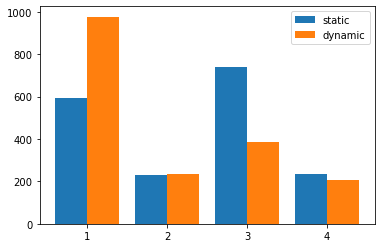

In [767]:
#сравнение количества песен, попавших в одну четверть
X=dict_quarters_s.keys()

X_axis = np.arange(len(X)) 

dict_quarters_s_all = {k : dict_quarters_s.get(k,0)+dict_quarters_s_2015.get(k,0) for k in set(dict_quarters_s)}
dict_quarters_d_all = {k : dict_quarters_d.get(k,0)+dict_quarters_d_2015.get(k,0) for k in set(dict_quarters_d)}

plt.bar(X_axis - 0.2, dict_quarters_s_all.values(), 0.4, label = 'static') 
plt.bar(X_axis + 0.2, dict_quarters_d_all.values(), 0.4, label = 'dynamic')
plt.xticks(X_axis, X) 
plt.legend() 
plt.show() 

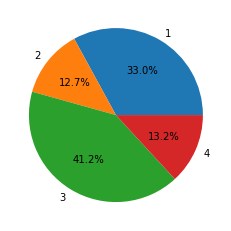

In [768]:
#статистическое распределение попаданий в четверти
plt.pie(dict_quarters_s_all.values(),labels=dict_quarters_s_all.keys(),autopct= '%1.1f%%')
plt.show() 

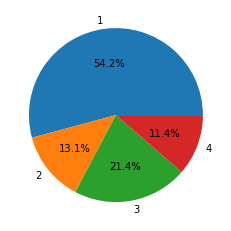

In [769]:
#динамическое распределение попаданий в четверти
plt.pie(dict_quarters_d_all.values(),labels=dict_quarters_d_all.keys(),autopct= '%1.1f%%')
plt.show()

На основе arousal и valence в df_static_averaged_1_2000 и df_static_averaged_2000_2058 создадим новый столбец, содержащий номер класса для данного фрагмента, следующим образом: ![диаграмма](https://www.researchgate.net/profile/Yi-Hsuan-Yang/publication/254004106/figure/fig1/AS:298208942149638@1448109960909/The-2D-valence-arousal-emotion-space-Russell-1980-the-position-of-the-affective.png)

In [770]:
#создаем столбец с индексом класса
def index_class(arousal, valence):
    if ((arousal>0) and (valence>0)):
        return 1
    if ((arousal>0) and (valence<=0)):
        return 2
    if ((arousal<=0) and (valence<=0)):
        return 3
    if ((arousal<=0) and (valence>0)):
        return 4
    
indexes_class_1_2000 = [index_class(normilize(df_static_averaged_1_2000[' arousal_mean'].loc[i]), normilize(df_static_averaged_1_2000[' valence_mean'].loc[i])) for i in df_static_averaged_1_2000.index]
df_static_averaged_1_2000["class"] = indexes_class_1_2000
indexes_class_2000_2058 = [index_class(normilize(df_static_averaged_2000_2058[' arousal_mean'].loc[i]), normilize(df_static_averaged_2000_2058[' valence_mean'].loc[i])) for i in df_static_averaged_2000_2058.index]
df_static_averaged_2000_2058["class"] = indexes_class_2000_2058

In [771]:
df_static_averaged_1_2000.head()

,valence_mean,valence_std,arousal_mean,arousal_std,class
song_id,,,,,
2,3.1,0.94,3.0,0.63,3
3,3.5,1.75,3.3,1.62,3
4,5.7,1.42,5.5,1.63,1
5,4.4,2.01,5.3,1.85,2
7,5.8,1.47,6.4,1.69,1


In [772]:
df_static_averaged_2000_2058.head()

,valence_mean,valence_std,valence_ max_mean,valence_max_std,valence_min_mean,valence_min_std,arousal_mean,arousal_std,arousal_max_mean,arousal_max_std,arousal_min_mean,arousal_min_std,class
song_id,,,,,,,,,,,,,
2001,3.2,0.98,5.0,1.41,2.2,0.98,6.6,0.80,8.6,0.49,3.4,1.02,2
2002,6.4,0.49,8.2,0.98,5.0,1.10,5.2,1.17,7.4,1.36,2.2,1.17,1
2003,5.4,1.50,7.2,1.17,3.4,1.02,4.6,1.85,6.2,2.04,1.4,0.49,4
2004,5.0,1.10,6.4,1.02,3.2,1.17,4.8,1.60,6.0,2.28,2.8,0.98,3
2005,3.8,1.17,5.0,1.10,1.6,0.80,5.2,0.75,8.4,0.80,2.0,1.10,2


In [773]:
#!pip install librosa

In [774]:
#!pip3 install pydub

In [775]:
#!pip install ffmpeg-python

In [776]:
import IPython.display as ipd
import librosa
import librosa.display
from pydub import AudioSegment

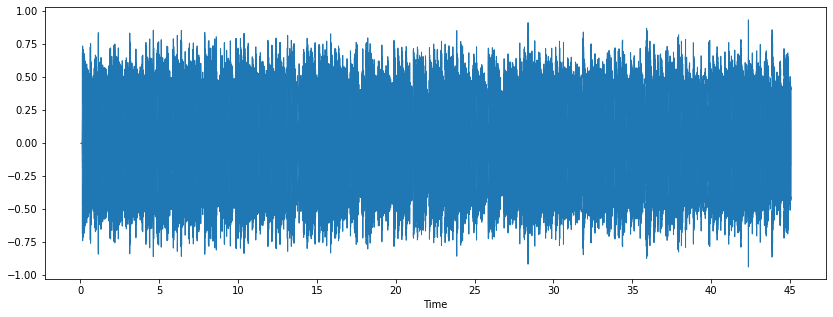

In [777]:
### 1 class song 7.mp3

sound = AudioSegment.from_mp3('audio_data/DEAM_audio/MEMD_audio/7.mp3')
sound.export('audio_data/DEAM_audio/7.wav', format='wav')

filename ='audio_data/DEAM_audio/7.wav'
plt.figure(figsize=(14,5))
song7,sample_rate=librosa.load(filename)
librosa.display.waveshow(song7,sr=sample_rate)
ipd.Audio(filename)

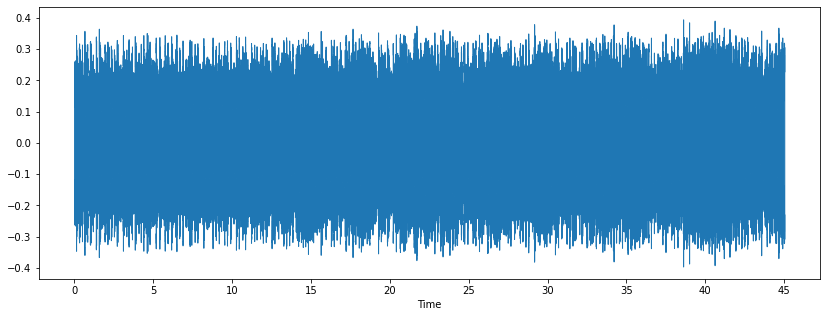

In [778]:
###2 class song 1996.mp3

sound = AudioSegment.from_mp3('audio_data/DEAM_audio/MEMD_audio/1996.mp3')
sound.export('audio_data/DEAM_audio/1996.wav', format='wav')

filename ='audio_data/DEAM_audio/1996.wav'
plt.figure(figsize=(14,5))
song1996,sample_rate=librosa.load(filename)
librosa.display.waveshow(song1996,sr=sample_rate)
ipd.Audio(filename)

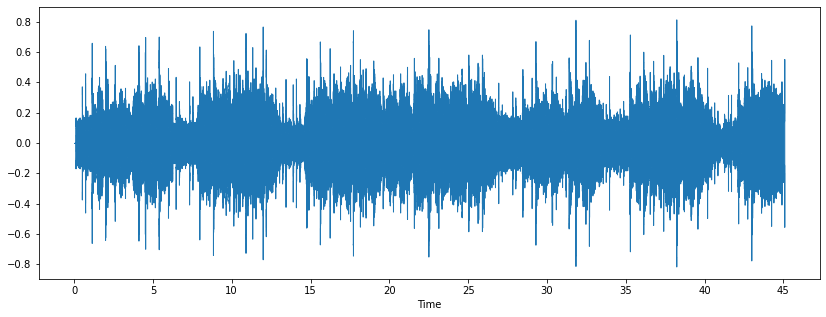

In [779]:
###3 class song 2.mp3

sound = AudioSegment.from_mp3('audio_data/DEAM_audio/MEMD_audio/2.mp3')
sound.export('audio_data/DEAM_audio/2.wav', format='wav')

filename ='audio_data/DEAM_audio/2.wav'
plt.figure(figsize=(14,5))
song2,sample_rate=librosa.load(filename)
librosa.display.waveshow(song2,sr=sample_rate)
ipd.Audio(filename)

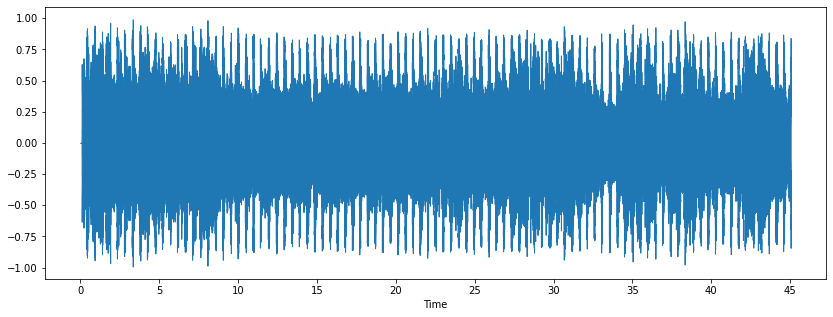

In [780]:
###4 class song 19.mp3

sound = AudioSegment.from_mp3('audio_data/DEAM_audio/MEMD_audio/19.mp3')
sound.export('audio_data/DEAM_audio/19.wav', format='wav')

filename ='audio_data/DEAM_audio/19.wav'
plt.figure(figsize=(14,5))
song19,sample_rate=librosa.load(filename)
librosa.display.waveshow(song19,sr=sample_rate)
ipd.Audio(filename)

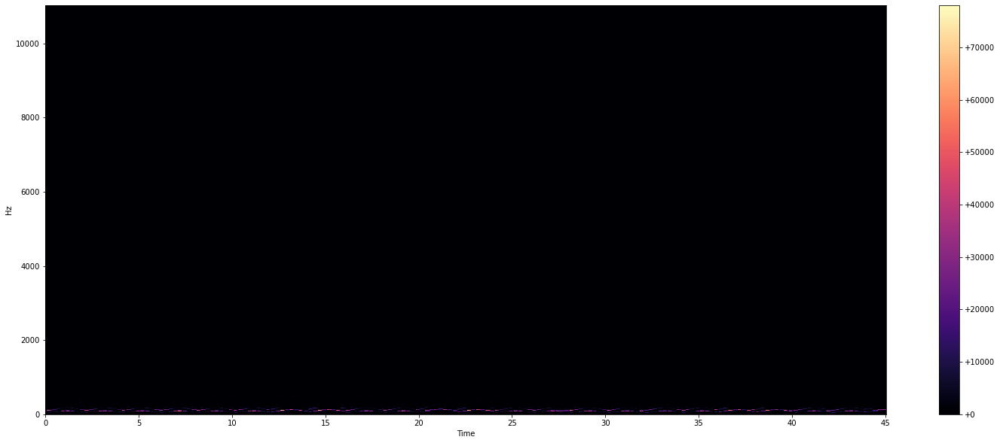

In [781]:
#спектрограмма для 7.mp3
song7_stft = librosa.stft(song7)
song7_stft_energy = np.abs(song7_stft) ** 2
plt.figure(figsize=(25, 10))
librosa.display.specshow(song7_stft_energy, sr=sample_rate, x_axis="time", y_axis='linear')
plt.colorbar(format="%+2.f")

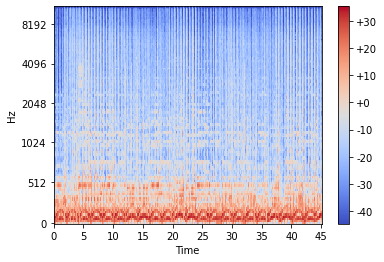

In [782]:
#mel спектрограмма для 7.mp3
mel_spectrogram = librosa.feature.melspectrogram(y=song7,sr=sample_rate)
log_mel_spectrogram = librosa.power_to_db(mel_spectrogram)
librosa.display.specshow(log_mel_spectrogram, x_axis="time",y_axis="mel", sr=sample_rate)
plt.colorbar(format="%+2.f")

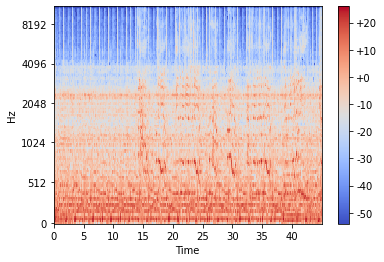

In [783]:
#mel спектрограмма для 1996.mp3
mel_spectrogram = librosa.feature.melspectrogram(y=song1996,sr=sample_rate)
log_mel_spectrogram = librosa.power_to_db(mel_spectrogram)
librosa.display.specshow(log_mel_spectrogram, x_axis="time",y_axis="mel", sr=sample_rate)
plt.colorbar(format="%+2.f")

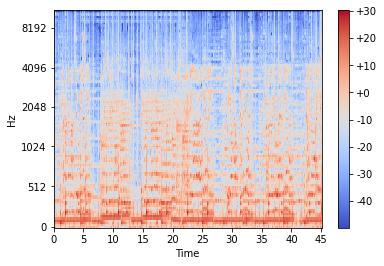

In [784]:
#mel спектрограмма для 2.mp3
mel_spectrogram = librosa.feature.melspectrogram(y=song2,sr=sample_rate)
log_mel_spectrogram = librosa.power_to_db(mel_spectrogram)
librosa.display.specshow(log_mel_spectrogram, x_axis="time",y_axis="mel", sr=sample_rate)
plt.colorbar(format="%+2.f")

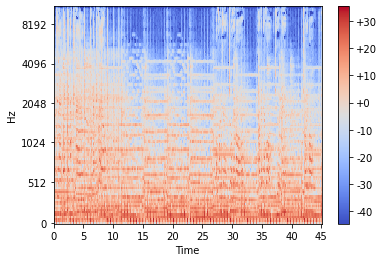

In [785]:
#mel спектрограмма для 19.mp3
mel_spectrogram = librosa.feature.melspectrogram(y=song19,sr=sample_rate)
log_mel_spectrogram = librosa.power_to_db(mel_spectrogram)
librosa.display.specshow(log_mel_spectrogram, x_axis="time",y_axis="mel", sr=sample_rate)
plt.colorbar(format="%+2.f")

In [786]:
df_static_averaged_1_2000.head(20)

,valence_mean,valence_std,arousal_mean,arousal_std,class
song_id,,,,,
2,3.1,0.94,3.0,0.63,3
3,3.5,1.75,3.3,1.62,3
4,5.7,1.42,5.5,1.63,1
5,4.4,2.01,5.3,1.85,2
7,5.8,1.47,6.4,1.69,1
8,3.2,1.40,4.8,1.54,3
10,4.0,1.67,4.7,1.85,3
12,5.5,1.91,5.8,1.89,1
13,3.2,1.40,4.0,1.67,3
